In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from tqdm import tqdm
import string 
df = pd.read_csv('../input/flickr8k/captions.txt' , sep=',')
df = df.rename(columns={"image": "image_name", "caption": "image_caption"})
df['image_caption'] = df['image_caption'].astype(str)
df['image_name'] = df['image_name'].astype(str)
def get_caption_list(df):
    caption_list = df['image_caption'].to_list()

    def clean_captions(caption_list):
        table = str.maketrans('', '', string.punctuation)

        for i in (range(len(caption_list))):
                desc = caption_list[i]
                # tokenize
                desc = desc.split()
                # convert to lower case
                desc = [word.lower() for word in desc]
                # remove punctuation from each token
                desc = [w.translate(table) for w in desc]
                # remove hanging 's' and 'a'
                desc = [word for word in desc if len(word)>1]
                # remove tokens with numbers in them
                desc = [word for word in desc if word.isalpha()]
                # store as string
                caption_list[i] =  ' '.join(desc)

        return (caption_list)
    caption_list = clean_captions(caption_list)
    
    for i, caption in enumerate(caption_list):
        caption_list[i] = '<start> ' + caption + ' <end>'
    
    
    return caption_list
caption_list = get_caption_list(df)
df['image_caption'] = caption_list
vocabulary = []
for i, key  in enumerate(caption_list):
    word_list = (caption_list[i].split())
    for word in word_list:
        vocabulary.append(word)
print('Original Vocabulary Size: %d' % len(vocabulary))
from collections import Counter 
  
def removeElements(lst, k): 
    counted = Counter(lst) 
    return [el for el in lst if counted[el] >= k] 

#k = 8
#vocabulary = ((removeElements(vocabulary, k))) 

vocabulary = set(vocabulary)
#vocabulary.update(['<unk>'])
#ixtoword = {}
#wordtoix = {}
#ix = 1
#for w in vocabulary:
#    wordtoix[w] = ix
#    ixtoword[ix] = w
#    ix += 1
ixtoword = np.load('../input/fork-of-image-captioning/ixtoword.npy',allow_pickle='TRUE').item()
wordtoix = np.load('../input/fork-of-image-captioning/wordtoix.npy',allow_pickle='TRUE').item()
max(len(d.split()) for d in caption_list)
'''
for i in range(75):
    
    my_len = len(list((d) for d in caption_list if((len(d.split()))>= i)))
    
    if (my_len != 0):
        
        print("LEN {}.....{}".format(i, ( my_len)))

'''
caption_df =  pd.Series(caption_list, name ='image_caption') 
image_name_df = df['image_name']
df_new = pd.concat([image_name_df, caption_df], axis=1)
df_new = df_new.dropna(axis= 0)

Original Vocabulary Size: 453811


In [2]:
from sklearn.model_selection import train_test_split
df_train , df_test = train_test_split(df,test_size=0.33, random_state=42)
df_train , df_val = train_test_split(df_train, test_size = 0.2 , random_state= 42)

In [3]:
def same_length_caption(caption , max_len=50):

    '''
    Takes caption as input and makes them of equal length
    
    Parameters:-
    caption (list) - The list of embedded caption to be made of particular length
    max_len (int) - The max length of the caption
    
    Return type:-
    
    caption (list) :- Returns a list with zero padding of length = max_len
    '''
    
    
    if(len(caption) == max_len):
        return (caption)
    else:
        for i in range((max_len-len(caption))):
            caption.append(0)
    return caption
def word_to_ix(caption , vocab):
    '''
    Maps the words to integers according to custom vocabulary
    
    Parameters:-
    caption (list) - The caption to be embedded
    vocab (dict) - The custom mapping that wil be used as vocabulary
    
    Return type:-
    
    caption (list) :- Returns a list after mapping them according to 'vocab'
    '''
        
    transformed_caption=[]
    for word in caption:
        if (word in wordtoix.keys()):
            transformed_caption.append(wordtoix[word])
        #else:
        #    transformed_caption.append(wordtoix['<unk>'])
    return (transformed_caption)
        
def ix_to_word(caption , vocab):
    '''
    Takes caption as input and maps them to words as defined by 'vocab'
    
    Parameters:-
    caption (list) - The list of embedded caption to be made of particular length
    vocab (dict) - The dictionary that wil be used as mapping
    
    Return type:-
    
    caption (list) :- Returns a list after converting respective integers to words according to vocab
    '''
    
    transformed_caption=[]
    for word in caption:
        if (word in ixtoword.keys()):
            transformed_caption.append(ixtoword[word])
        else:
            transformed_caption.append('<unk>')
    return (transformed_caption)


In [4]:
def generator(samples, batch_size=32):

    """
    Yields the next training batch.
    Suppose `samples` is an array [[image1_filename,label1], [image2_filename,label2],...].
    """
    num_samples = len(samples)
    
    while True:
        for offset in range(0, num_samples, batch_size):
            batch_samples = samples.iloc[offset:offset+batch_size]

            input_seq=[]
            output_seq=[]
            features_list = []

            for batch_sample in batch_samples.index:


                caption_text = batch_samples.at[batch_sample , 'image_caption']
                caption = caption_text.split()
                caption = word_to_ix(caption , wordtoix)
                caption = same_length_caption(caption , max_len = 34)


                image_name = batch_samples.at[batch_sample , 'image_name']
                features = np.load('../input/image-caption-dataset/' 
                                   + image_name[0:-4]
                                   +'.npy'
                                  )
                features = (features).tolist()


                features_list.append(features)
                input_seq.append(caption[:-1])
                output_seq.append(caption[1:])




            features_list = np.array(features_list)
            input_seq = np.array(input_seq)
            output_seq = np.array(output_seq)


            #if((features_list.shape != (32,2048)) or (input_seq.shape != (32,33)  )   or (output_seq.shape != (32,33) )):
            #    print("_________________________________________________________________________________")
            #    print('$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$')
            #    print(batch_samples.index)
            #    print('$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$')
            #    print("FEATURES_LIST SHAPE  -  {}".format(features_list.shape))
            #    print("INPUT_SEQ SHAPE  -  {}".format(input_seq.shape))
            #    print("OUTPUT_SEQ SHAPE  -  {}".format(output_seq.shape))
            #    print("_________________________________________________________________________________")


            yield [features_list, input_seq] ,output_seq
            #input_seq


In [5]:
model = tf.keras.models.load_model('../input/fork-of-image-captioning/my_file')


In [6]:
from IPython.display import display, Image


In [7]:
df_test_copy =  df_test.reset_index(drop=True)


In [8]:
test_generator = generator(df_test_copy , 100)
X_dummy , y_dummy = next(test_generator)
yhat = model.predict(X_dummy)
caption_list = [] 
for i in (range(len(yhat))):
              #display(Image(filename='../input/flickr8k/Images/'+df_test_copy.at[i, 'image_name']))
              
              predicted = yhat[i,:,:]
              
              s= []
              
              for each in range(33):
                  s.append(ix_to_word([np.argmax(predicted[each])] , ixtoword)[0])
                  
                  
                            
              #caption = ""
              #caption = (caption.join(s))
            
              cleaned_s = []
              
              for each in range(33):
                   
                    if (not(s[each]=='<unk>' or s[each]=='<end>')):
                        
                        cleaned_s.append(s[each])
              caption_list.append(cleaned_s)
              
              
                          


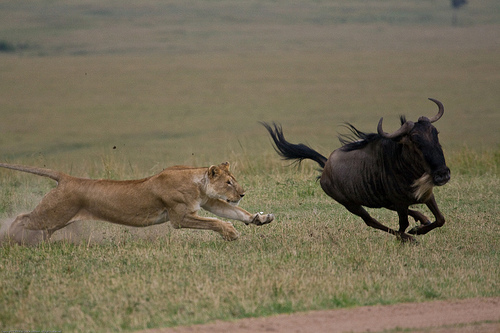

['lioness', 'lioness', 'field', 'is', 'chasing', 'dog', 'the']


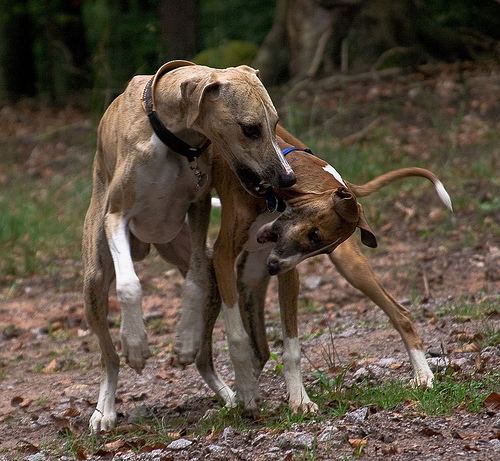

['two', 'dogs', 'dogs', 'are', 'the', 'grass', 'field']


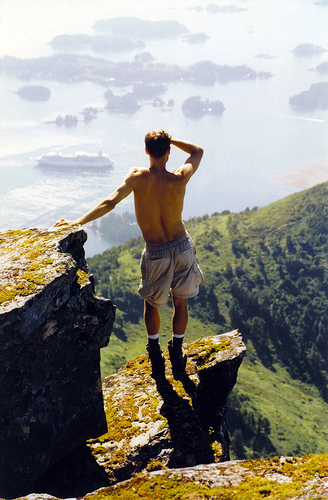

['shirtless', 'in', 'blue', 'and', 'climbing', 'on', 'top', 'overlooking', 'at', 'of', 'the', 'camera', 'of', 'behind', 'river']


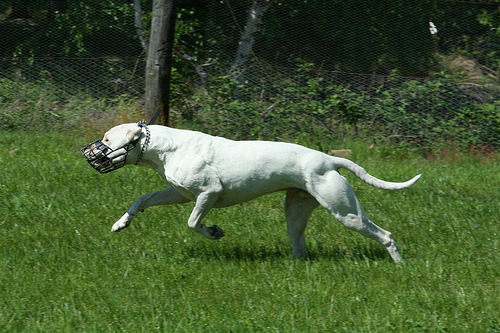

['white', 'furry', 'dog', 'running', 'running', 'through', 'the', 'grass']


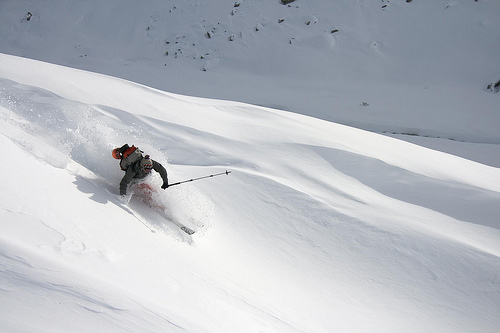

['skier', 'in', 'down', 'through']


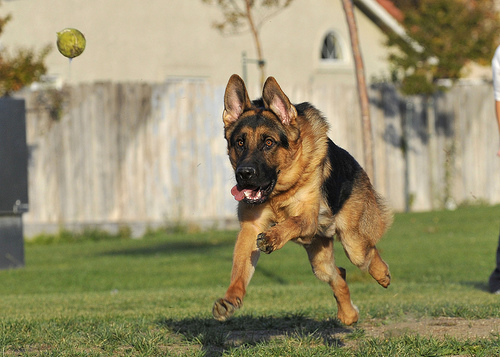

['the', 'chases', 'plays', 'toy', 'ball', 'in']


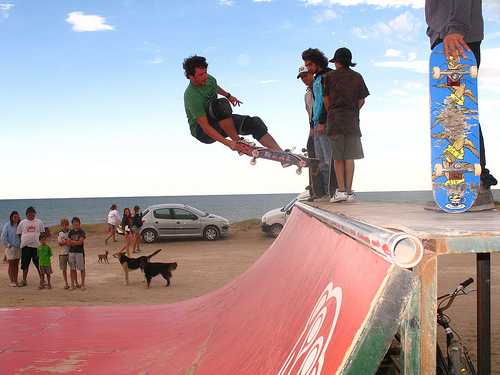

['man', 'in', 'doing', 'on', 'ramp', 'ramp', 'the', 'ocean']


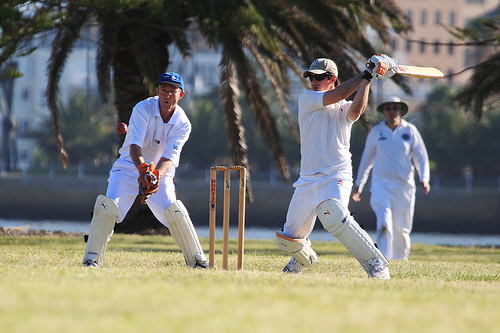

['two', 'men', 'in', 'in', 'white', 'and', 'the', 'at', 'man', 'man', 'in', 'down', 'to']


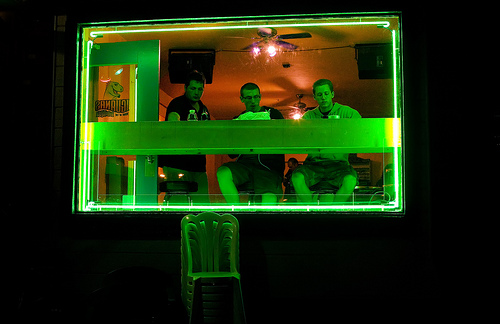

['man', 'people', 'sit', 'in', 'table', 'table', 'of', 'the', 'with']


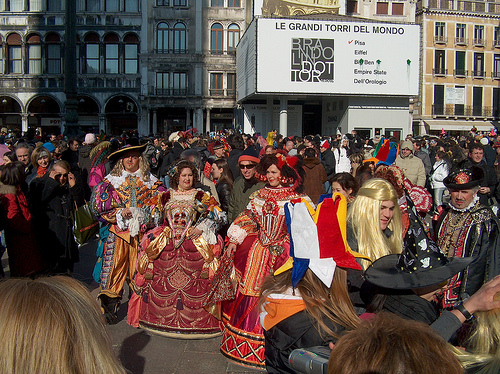

['crowd', 'are', 'man', 'group', 'of', 'people', 'at', 'front', 'busy', 'street']


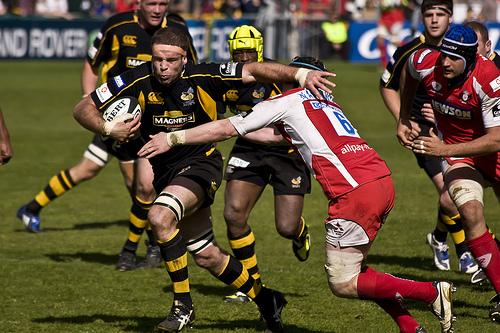

['man', 'player', 'attempts', 'to', 'get', 'for', 'goal', 'ball', 'orange', 'player', 'in', 'the', 'opposing', 'the', 'the']


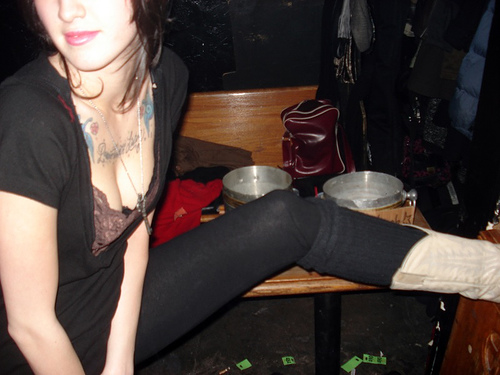

['woman', 'in', 'sitting', 'at', 'cellphone', 'while', 'in', 'her', 'while', 'from', 'smiles', 'man']


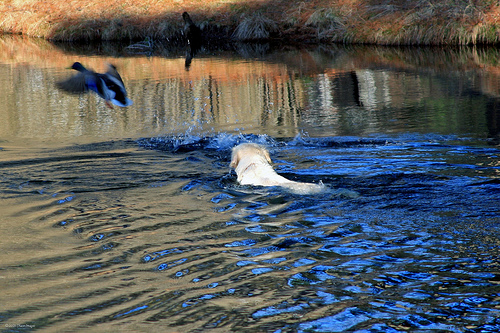

['white', 'orange', 'white', 'is', 'through', 'to', 'water', 'in', 'in']


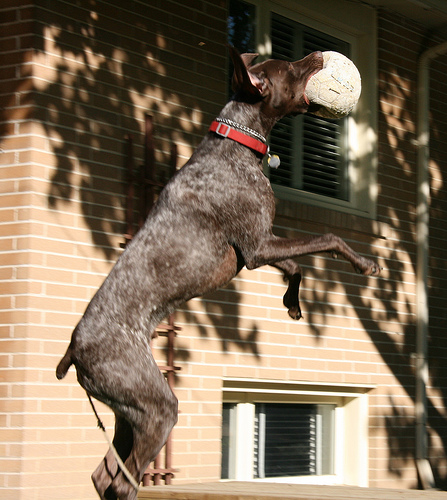

['dog', 'and', 'jumps', 'over', 'the', 'air', 'to', 'catch', 'ball', 'and']


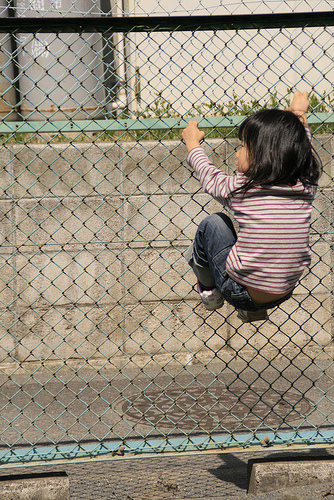

['child', 'girl', 'is', 'on', 'the']


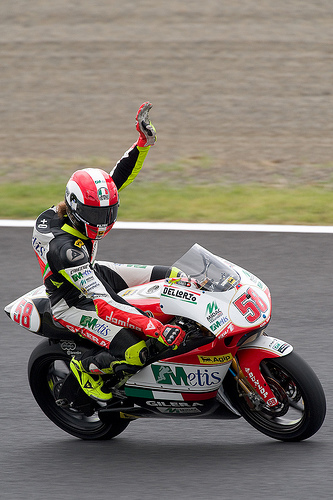

['man', 'biker', 'racer', 'is', 'his', 'knee', 'while', 'the']


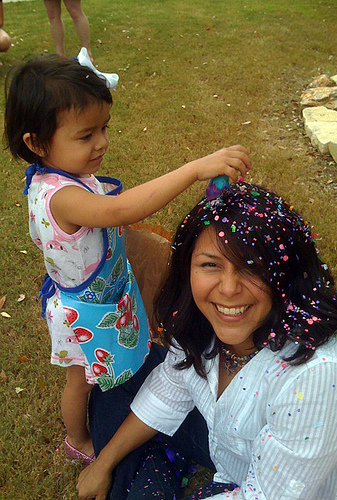

['girl', 'girl', 'in', 'her', 'the']


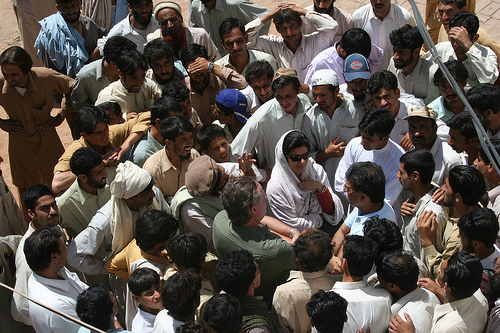

['group', 'off', 'group', 'of', 'people', 'in', 'in']


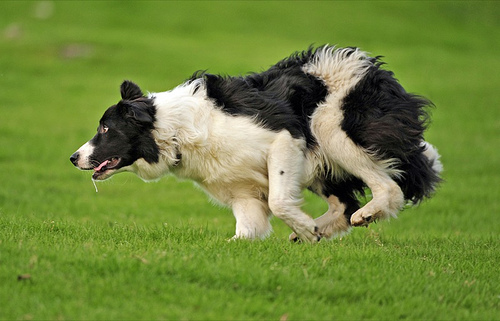

['two', 'black', 'and', 'white', 'dog', 'runs', 'running', 'on', 'the', 'green']


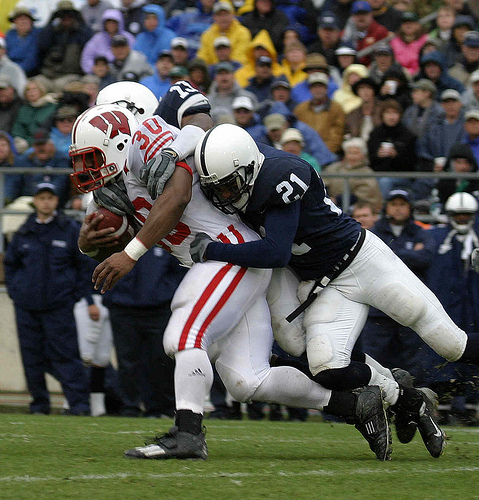

['football', 'player', 'in', 'the', 'ground', 'holds', 'the', 'ground', 'are', 'front', 'and', 'holds', 'ground', 'holds', 'the', 'ground', 'front', 'field', 'other', 'the', 'three', 'the', 'white']


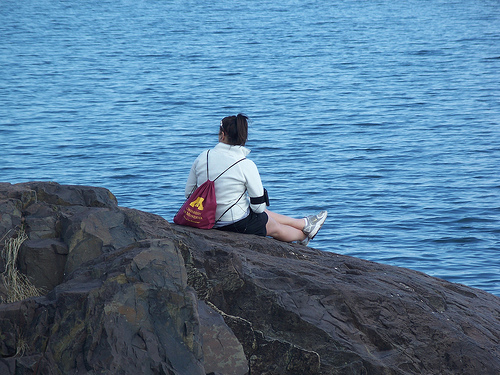

['man', 'is', 'on', 'the', 'overlooking', 'man', 'ocean', 'and']


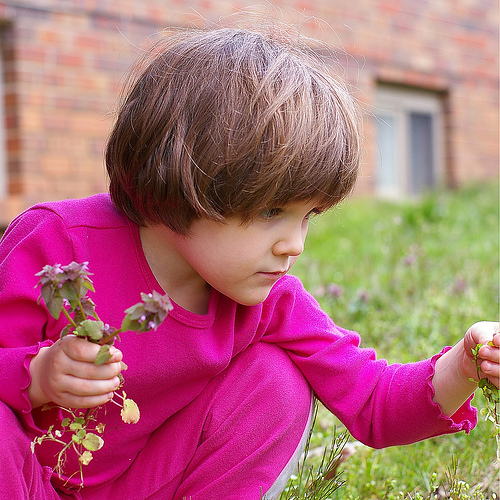

['girl', 'in', 'pink', 'dress', 'flowers', 'dressed']


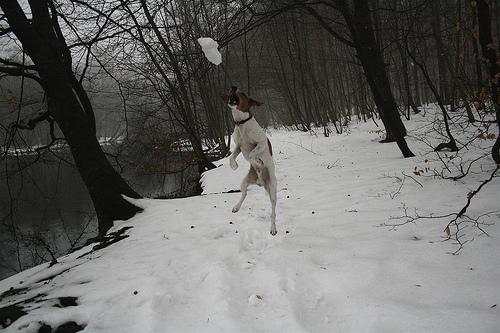

['dog', 'dog', 'white', 'dog', 'jumps', 'jumping', 'over', 'the', 'white']


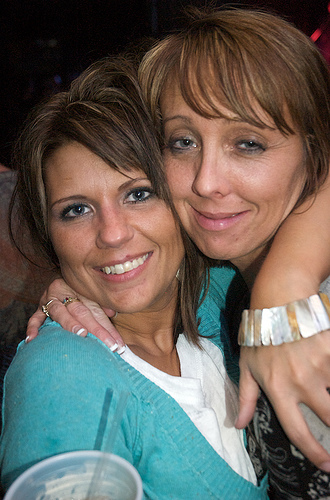

['two', 'women', 'sharing', 'matching', 'arms', 'crossed', 'each', 'other', 'the', 'air']


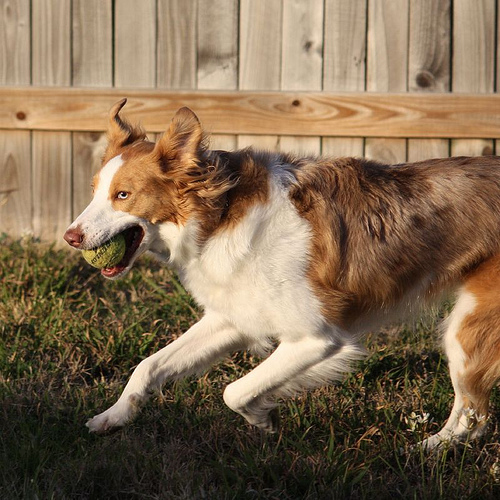

['brown', 'and', 'black', 'dog', 'is', 'in', 'green', 'fence', 'its', 'ball', 'in', 'its', 'mouth']


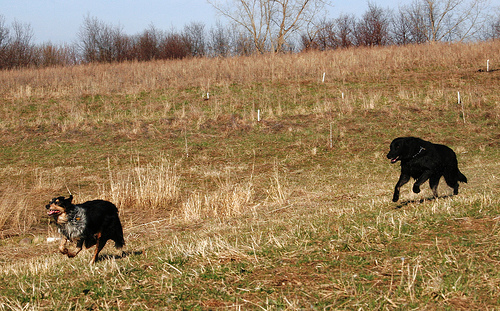

['two', 'dog', 'running', 'after', 'dog', 'dog', 'across', 'the', 'field']


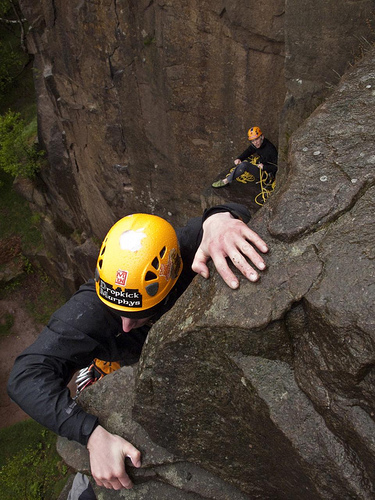

['mountain', 'in', 'white', 'helmet', 'is', 'cliff', 'mountain', 'of', 'cliff', 'rock']


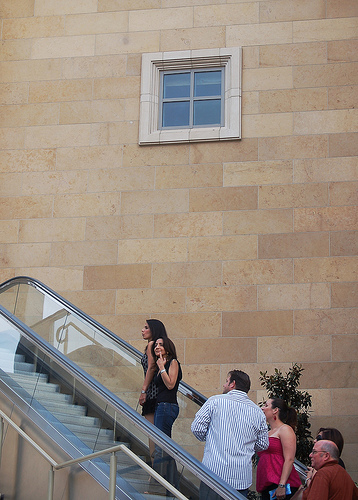

['people', 'are', 'down', 'an', 'sidewalk']


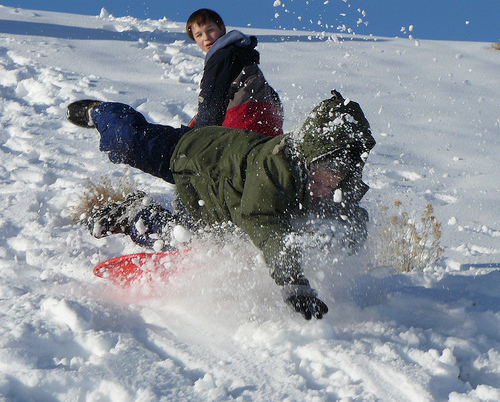

['man', 'dogs', 'are', 'in', 'the', 'snow', 'large']


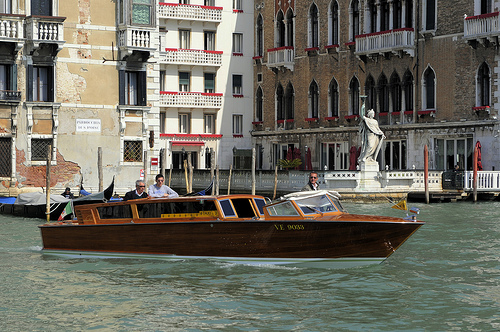

['two', 'are', 'winter', 'hats', 'bridge', 'through', 'the', 'street', 'building', 'lawn']


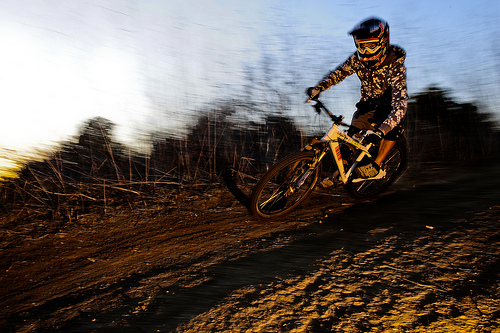

['person', 'rides', 'bike', 'bike']


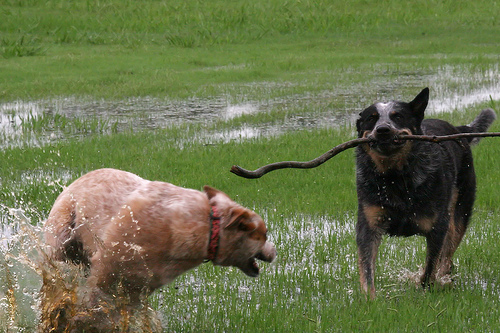

['the', 'white', 'are', 'on', 'the', 'field']


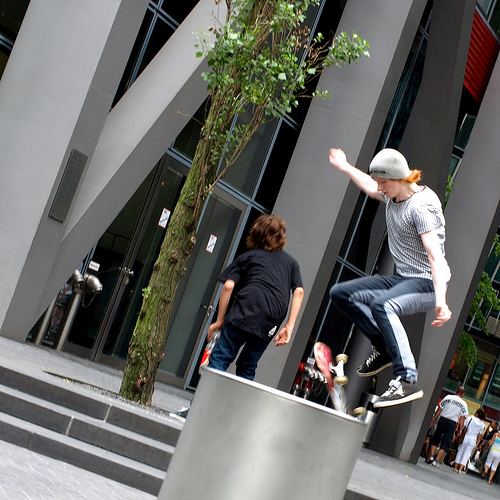

['skateboarder', 'in', 'ramp', 'street', 'building', 'of', 'building', 'building']


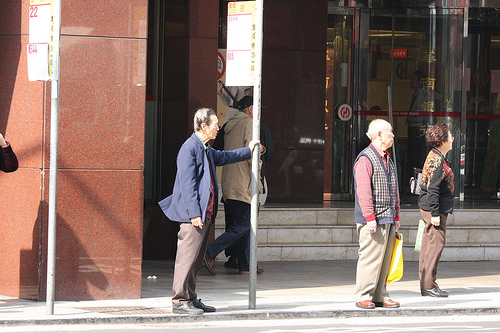

['three', 'men', 'are', 'standing', 'on', 'sidewalk', 'sidewalk', 'outside', 'the', 'walks']


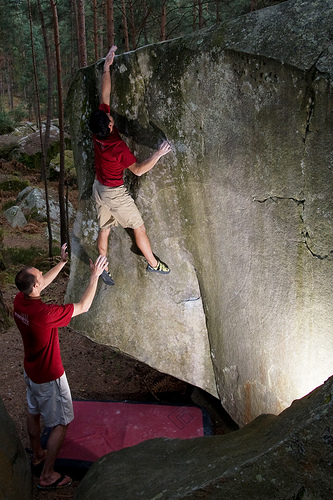

['man', 'in', 'up', 'side', 'of', 'rock']


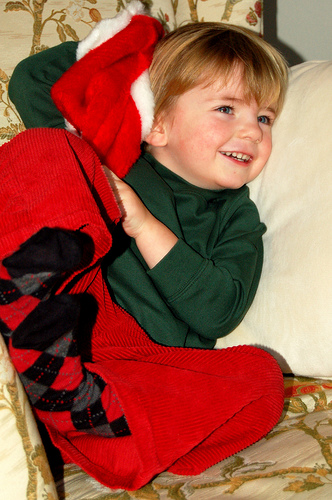

['little', 'in', 'couch', 'smiling', 'plastic', 'toy', 'another', 'hair']


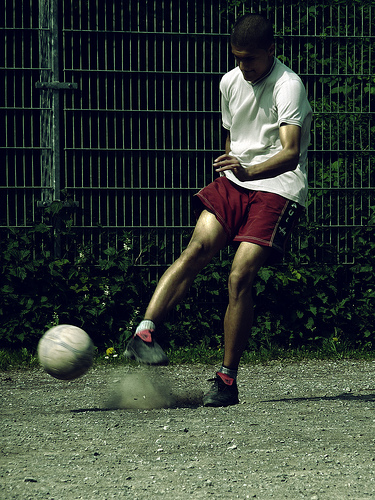

['the', 'plays', 'uniform', 'kicks', 'shorts', 'uniform', 'plays', 'soccer', 'ball']


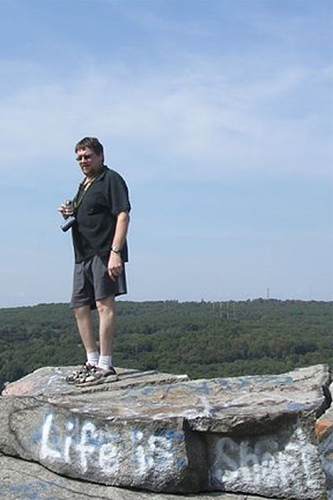

['man', 'in', 'on', 'the', 'with', 'holding', 'picture', 'the', 'air']


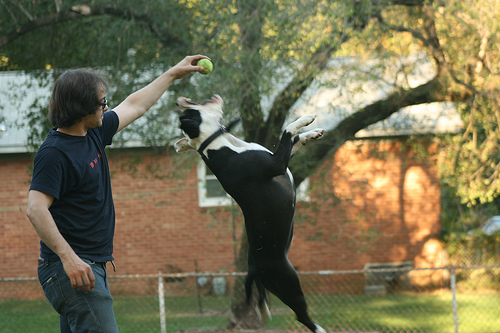

['man', 'in', 'ball', 'in', 'standing', 'chases', 'into', 'to', 'stick']


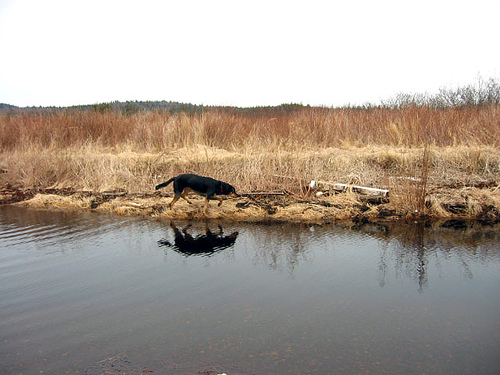

['dog', 'dog', 'with', 'with', 'river', 'with', 'with']


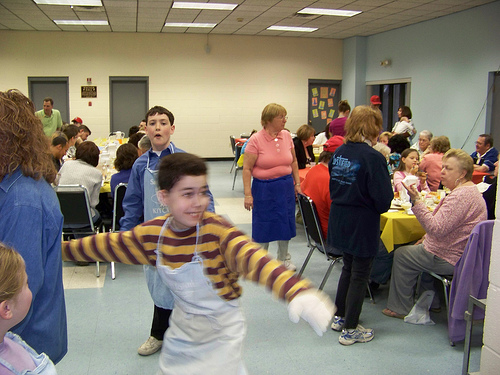

['three', 'are', 'colorful', 'hats', 'at', 'an', 'on', 'the', 'window', 'red', 'and', 'red', 'dress']


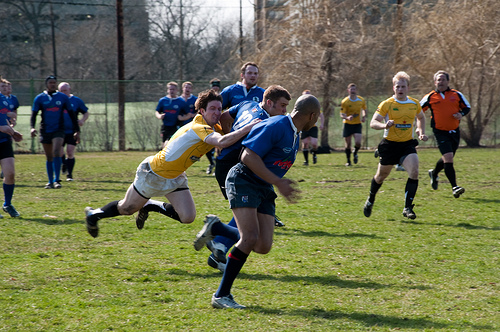

['man', 'player', 'is', 'the', 'field']


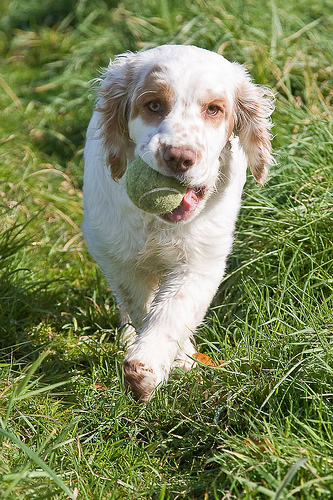

['white', 'white', 'is', 'an', 'ball', 'in', 'the', 'grass']


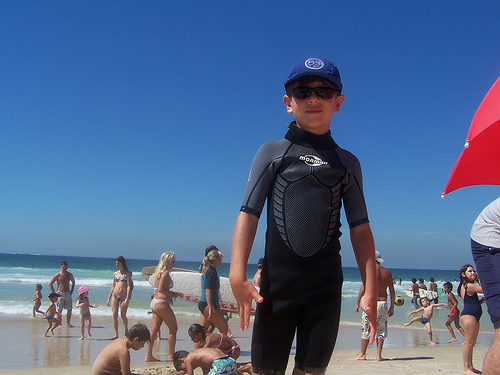

['boy', 'in', 'blue', 'stands', 'the', 'beach']


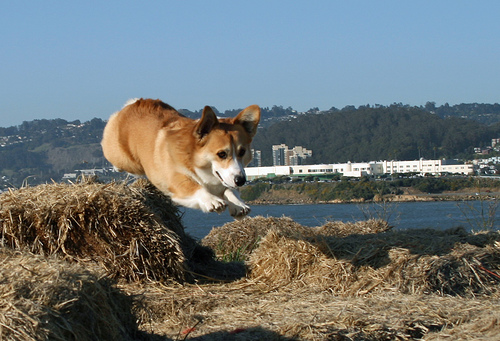

['brown', 'jumps', 'high', 'the', 'the', 'looks', 'it']


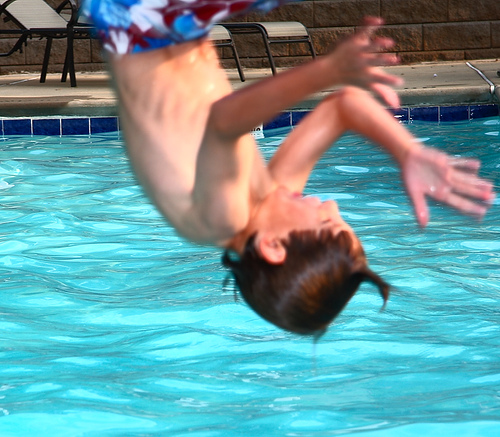

['boy', 'boy', 'jumping', 'the', 'trunks', 'is', 'diving', 'into', 'into', 'the', 'pool']


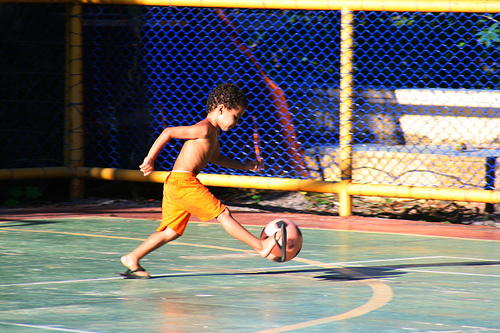

['group', 'boy', 'jumping', 'soccer', 'in', 'basketball', 'inflatable', 'backyard']


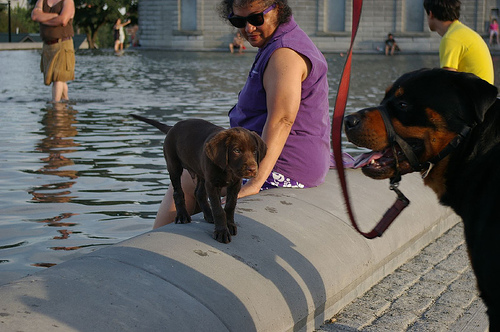

['woman', 'in', 'in', 'the', 'puppy', 'in', 'the', 'of', 'reads', 'out', 'the', 'on']


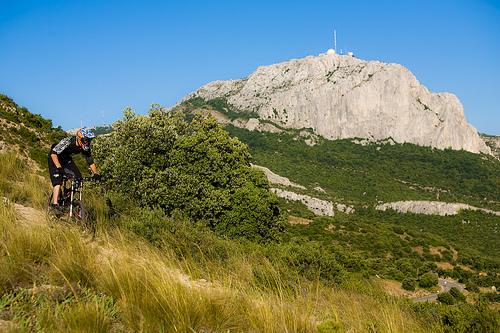

['the', 'wearing', 'at']


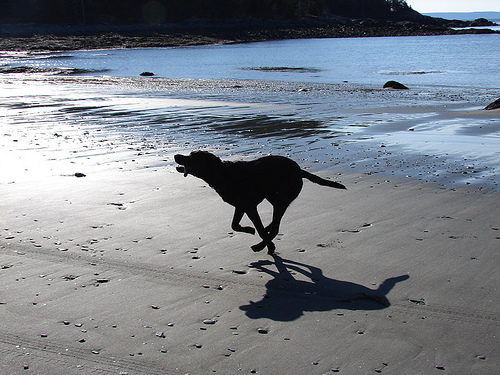

['dog', 'runs', 'on', 'the']


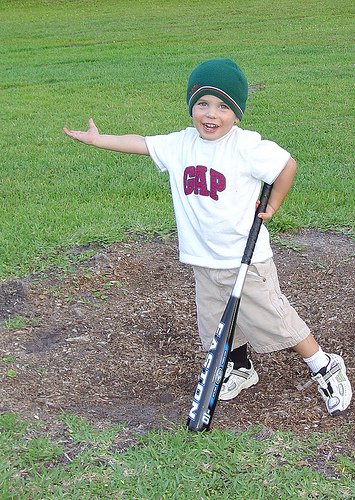

['child', 'wearing', 'down', 'hill', 'field', 'while', 'boy', 'the', 'the', 'hand']


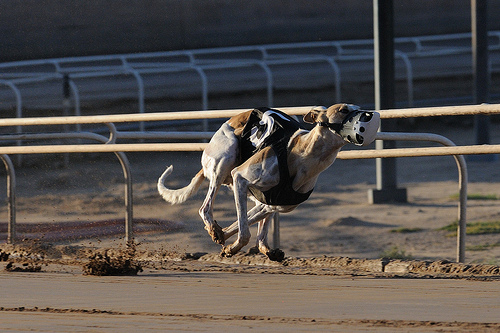

['muzzled', 'greyhound', 'dog', 'running', 'around', 'track']


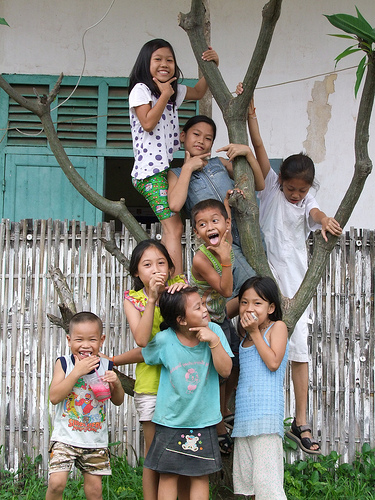

['the', 'children', 'children', 'are', 'faces', 'and', 'the']


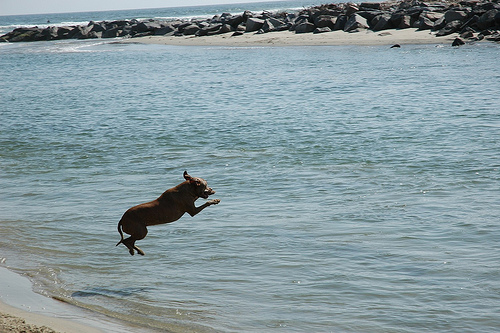

['man', 'dog', 'is', 'in', 'the', 'ocean']


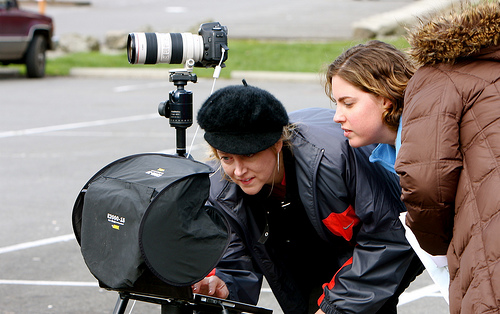

['two', 'women', 'are', 'together', 'together', 'look', 'on']


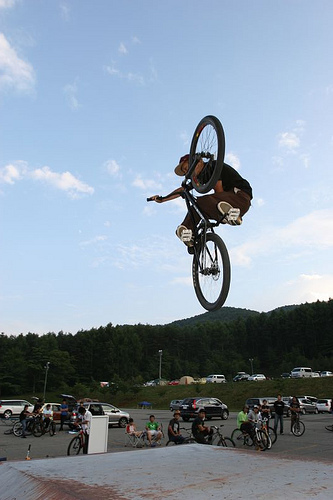

['bicyclist', 'on', 'performing', 'bicycle', 'on', 'bike', 'in']


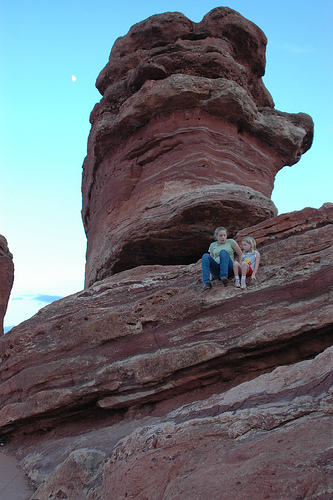

['boy', 'boys', 'climbing', 'on', 'rocky', 'middle', 'looking', 'rocky', 'indoor', 'high']


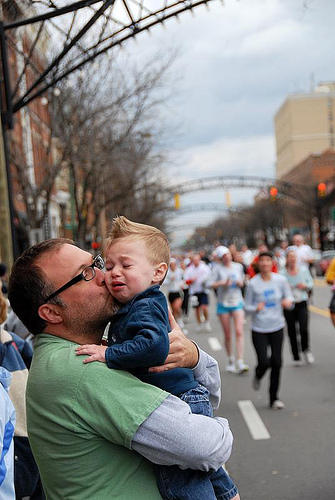

['man', 'in', 'up', 'red', 'while', 'helmet', 'out', 'the', 'face']


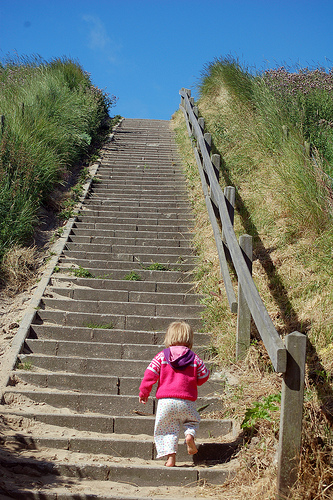

['small', 'child', 'climbs', 'steps', 'near', 'park']


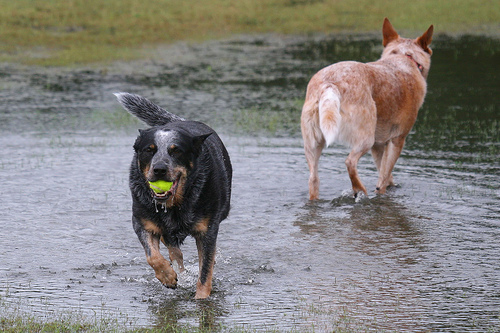

['black', 'dogs', 'run', 'in', 'the', 'one', 'of', 'water', 'ball', 'ball', 'in']


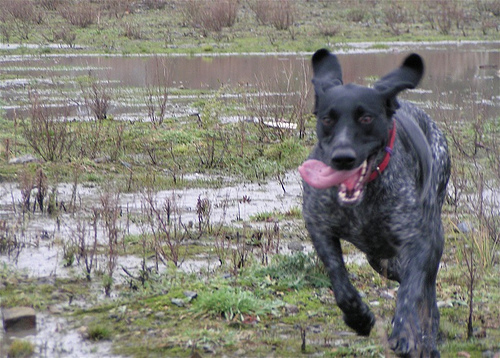

['black', 'running', 'through', 'the']


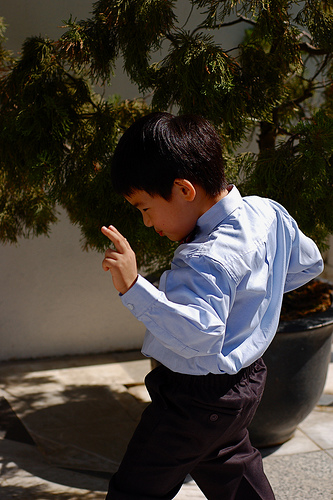

['young', 'boy', 'wearing', 'with', 'the', 'with']


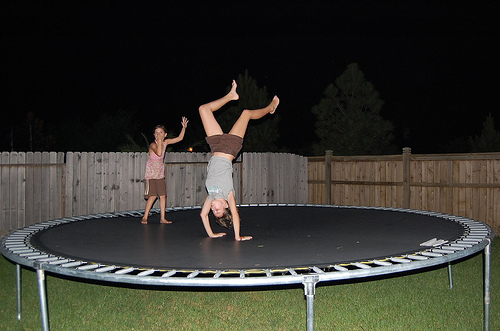

['two', 'young', 'on', 'standing', 'in', 'on', 'the']


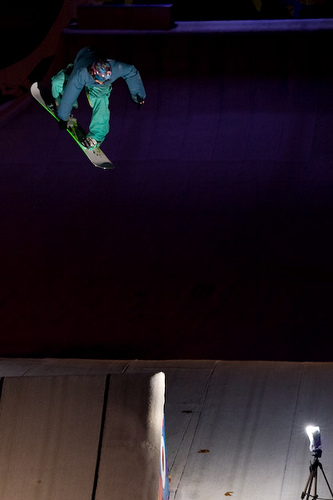

['man', 'jumps', 'through', 'the', 'air', 'at']


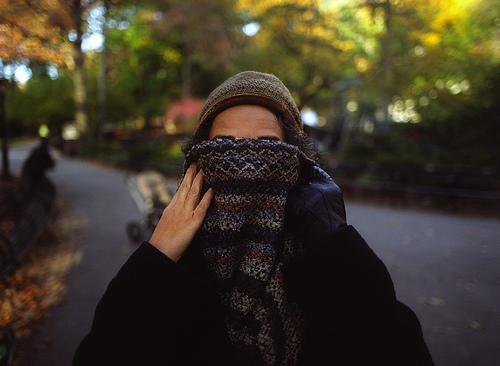

['the', 'in', 'in', 'snowy', 'face', 'in', 'her', 'scarf']


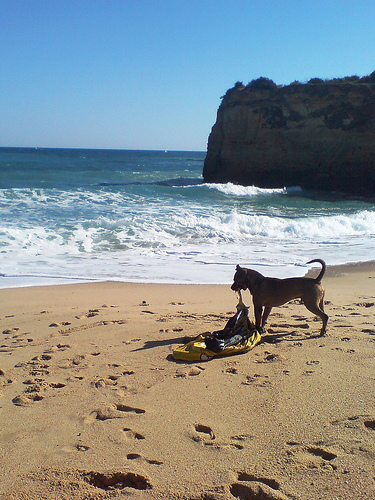

['the', 'is', 'jumped', 'on', 'the', 'arm', 'on', 'beach', 'beach']


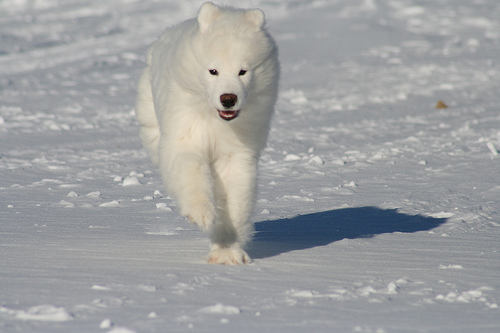

['white', 'white', 'dog', 'running', 'on', 'the', 'snow']


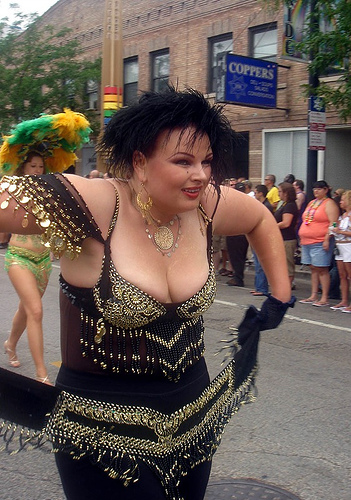

['woman', 'in', 'green', 'shirt', 'is', 'short', 'suit', 'points', 'store']


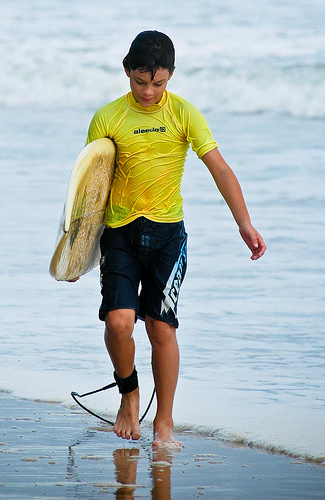

['boy', 'boy', 'in', 'the', 'beach', 'the', 'in']


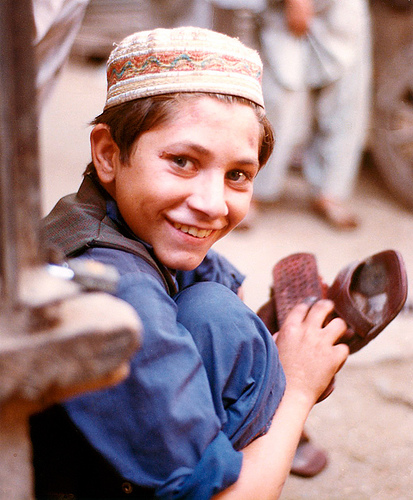

['child', 'in', 'ball', 'adults', 'near']


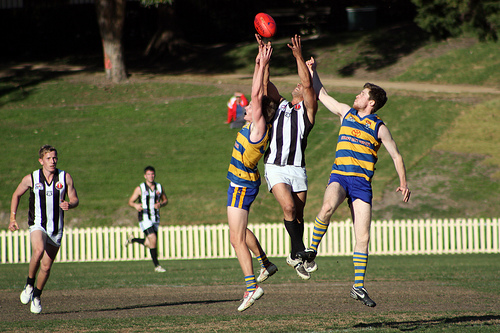

['two', 'rugby', 'men', 'play', 'soccer', 'in']


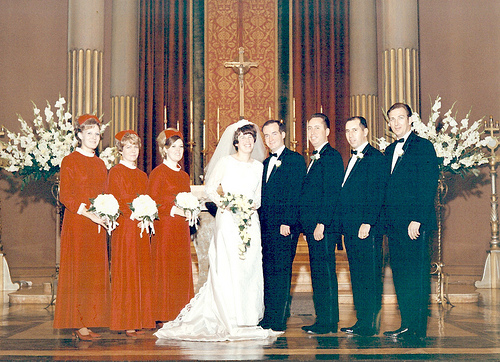

['the', 'of', 'picture', 'red', 'picture']


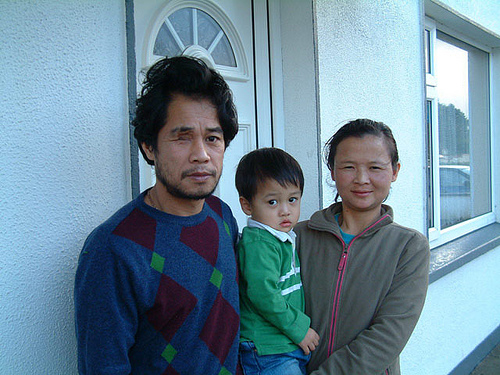

['man', 'with', 'and', 'two', 'sit']


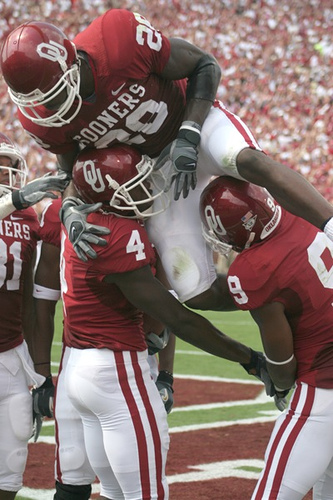

['the', 'football', 'players', 'are', 'orange', 'and', 'and', 'wearing', 'the', 'field']


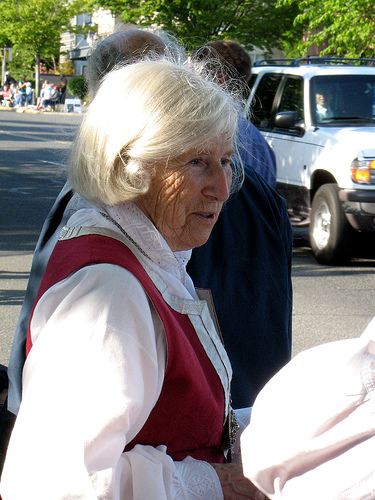

['woman', 'in', 'red', 'shirt', 'is', 'in', 'front']


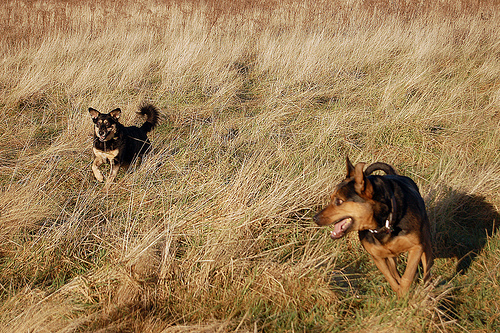

['two', 'dogs', 'dogs', 'white', 'dogs', 'running', 'through', 'field', 'grass', 'grass']


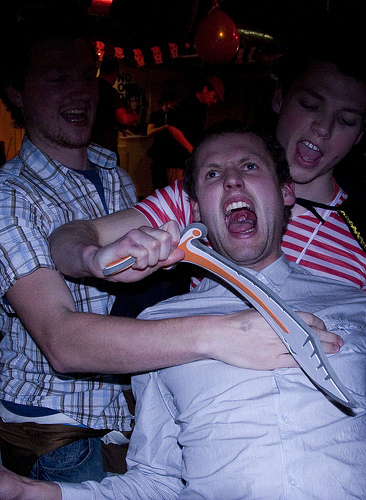

['there', 'young', 'and', 'one', 'are', 'are', 'are', 'has', 'making', 'up', 'out']


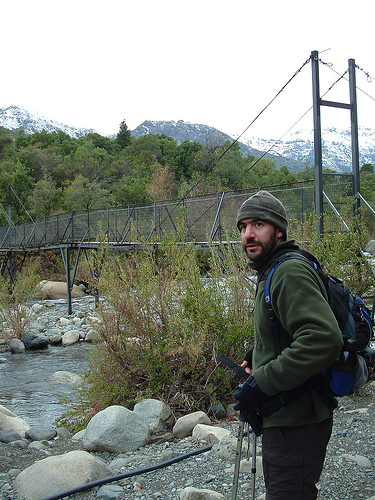

['there', 'man', 'is', 'long', 'is', 'is', 'head', 'is', 'sign', 'is', 'the', 'of', 'building', 'area', 'walk']


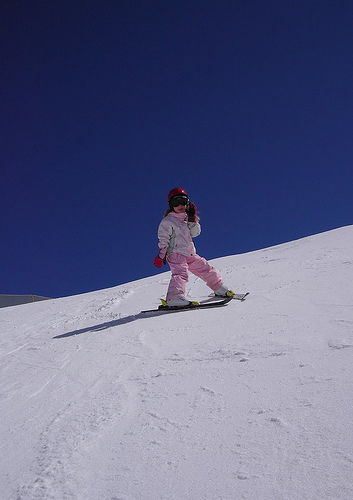

['child', 'skis', 'red', 'skis', 'with', 'red', 'is', 'snowboard']


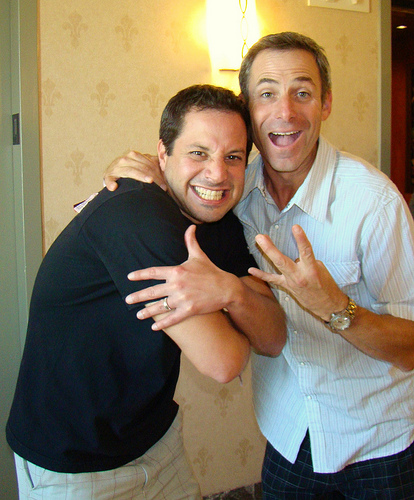

['two', 'men', 'are', 'two', 'other', 'one', 'for', 'the']


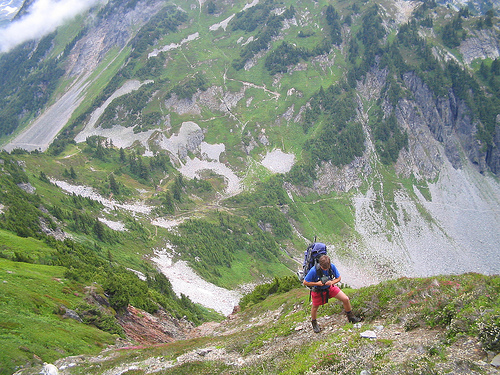

['hiker', 'man', 'is', 'rock', 'down', 'his', 'mountain']


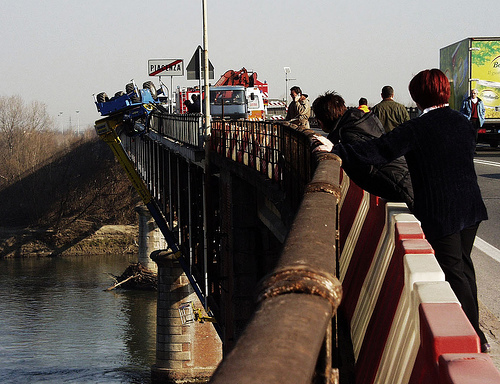

['several', 'people', 'are', 'on', 'the', 'near', 'two', 'area']


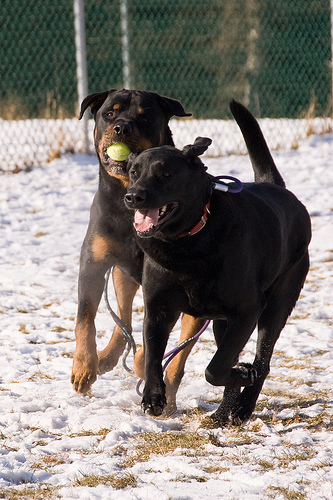

['two', 'dogs', 'dogs', 'run', 'side', 'one', 'ball', 'in', 'the', 'snow', 'field']


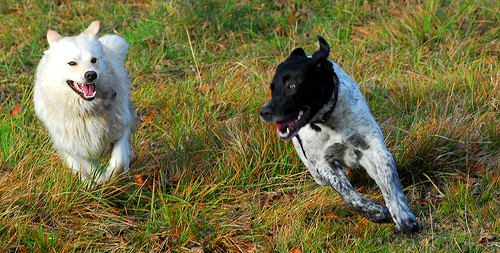

['two', 'dog', 'with', 'running', 'black', 'brown', 'dog', 'white', 'dog', 'in']


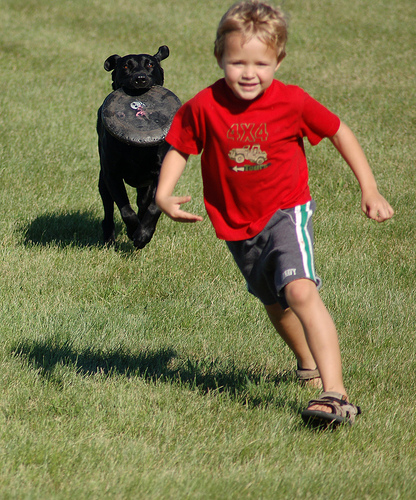

['little', 'and', 'with', 'after', 'in', 'red', 'and', 'yellow', 'toy']


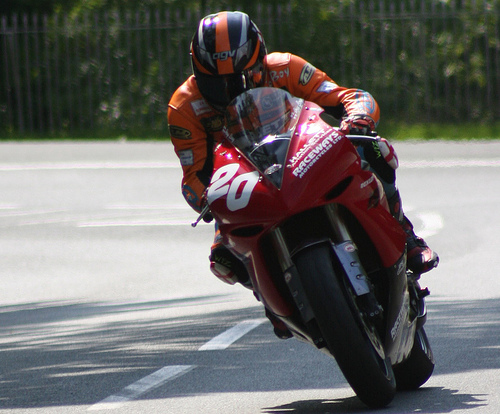

['motorcyclist', 'on', 'over', 'to', 'the', 'rides']


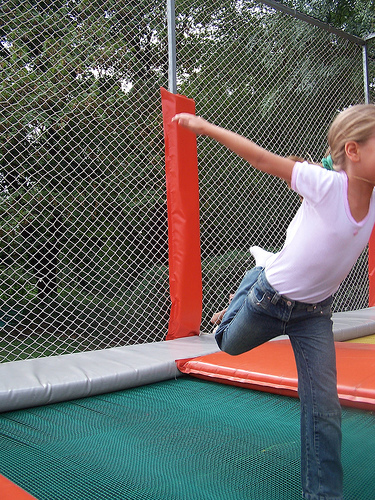

['girl', 'is', 'jumping', 'jumping', 'same', 'drinking', 'bar', 'room', 'with', 'green', 'same', 'and', 'green', 'and']


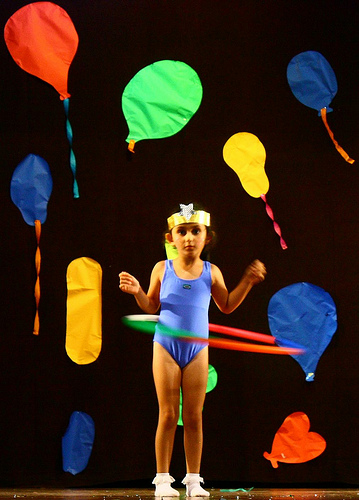

['child', 'is', 'green', 'and', 'and', 'and', 'stage', 'her', 'in', 'her', 'air']


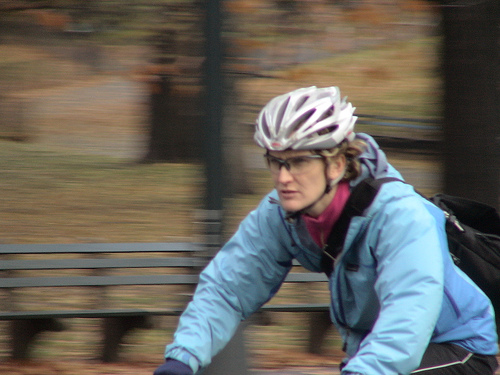

['woman', 'in', 'white', 'hat', 'is', 'hat', 'and', 'riding', 'up']


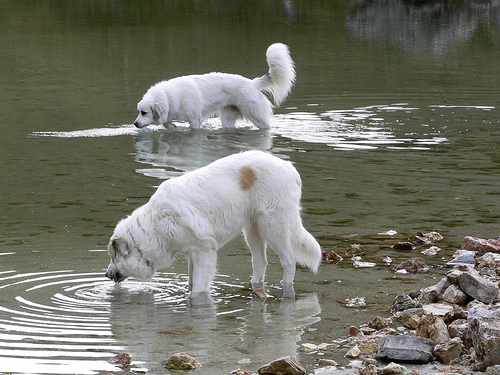

['two', 'black', 'dogs', 'are', 'hugging', 'water', 'from', 'of', 'the']


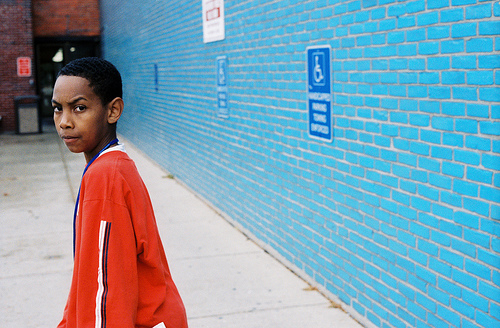

['the', 'old', 'man', 'woman', 'is', 'in', 'the', 'of', 'the', 'water', 'front', 'background', 'left']


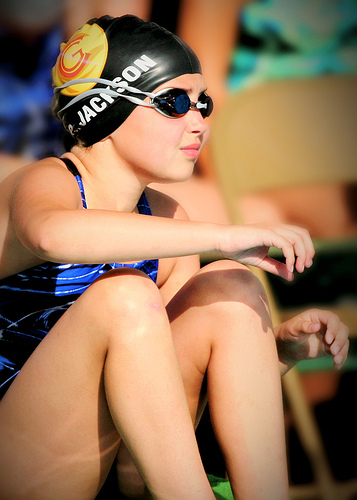

['woman', 'man', 'is', 'wearing', 'blue', 'and', 'has', 'at', 'the', 'air']


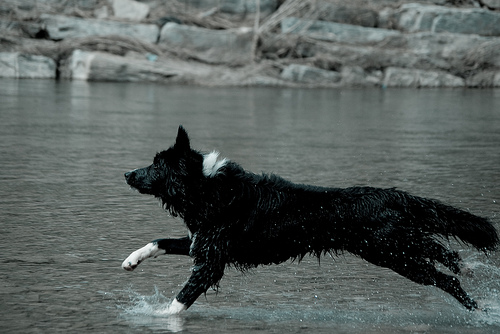

['black', 'dog', 'is', 'into', 'water']


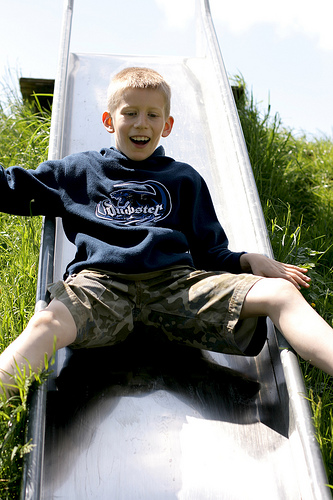

['man', 'boy', 'in', 'through', 'slide', 'another']


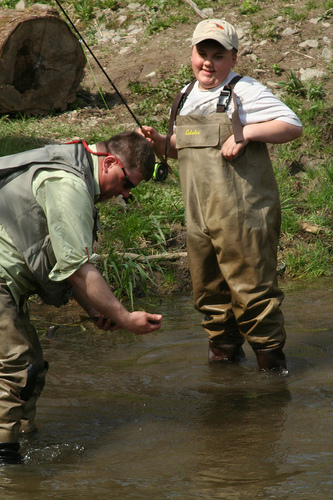

['two', 'fishing', 'woman', 'boy', 'fishing', 'an', 'are', 'on', 'the', 'water', 'water']


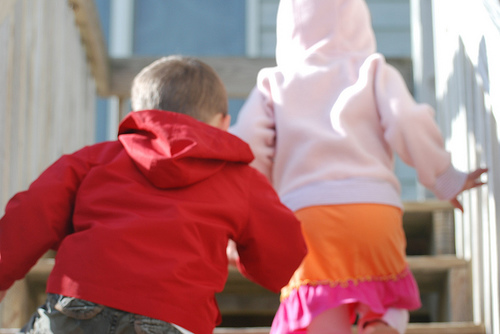

['two', 'boy', 'wearing', 'green', 'jacket', 'is', 'black', 'girl', 'in', 'blue', 'hoodie', 'walks', 'standing', 'on']


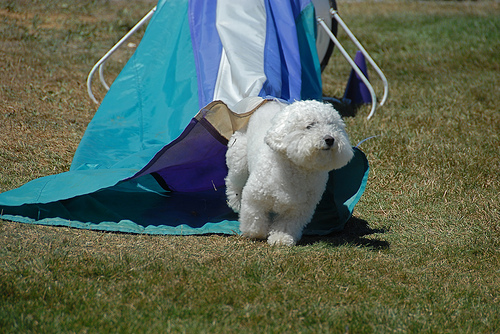

['the', 'and', 'is', 'running', 'over', 'the', 'grass', 'grass', 'obstacle', 'course']


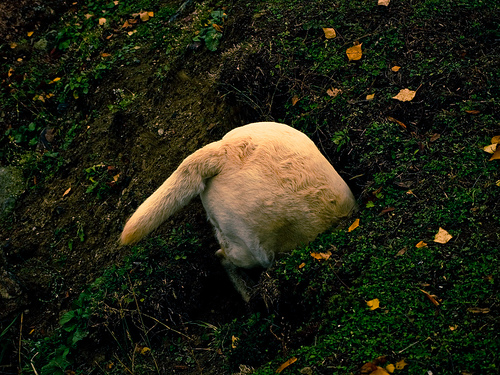

['dog', 'dog', 'is', 'digging', 'in', 'long', 'the', 'yard', 'half', 'half', 'stands', 'standing', 'to', 'the', 'air']


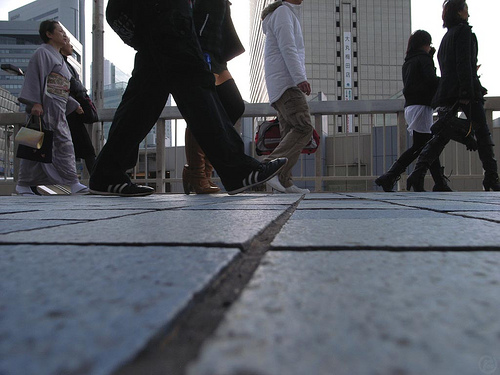

['the', 'people', 'are', 'walking', 'in', 'the', 'park', 'the', 'trees']


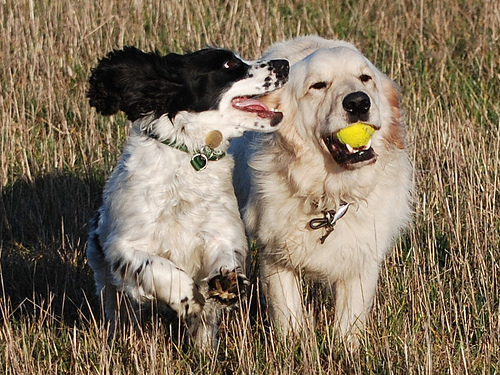

['two', 'dog', 'and', 'with', 'carrying', 'through', 'green', 'ball', 'in', 'his', 'mouth', 'another', 'man', 'follows', 'him']


In [9]:
for each in range(len(caption_list)):
    display(Image(filename='../input/flickr8k/Images/'+df_test_copy.at[each, 'image_name']))
    
    print(caption_list[each])

In [10]:
def word_to_ix_lang(lang_caption , vocab):
    '''
    Maps the words to integers according to custom vocabulary
    
    Parameters:-
    caption (list) - The caption to be embedded
    vocab (dict) - The custom mapping that wil be used as vocabulary
    
    Return type:-
    
    caption (list) :- Returns a list after mapping them according to 'vocab'
    '''
        
    transformed_caption=[]
    for word in lang_caption:
        if (word in vocab.keys()):
            transformed_caption.append(vocab[word])
        else:
            transformed_caption.append(vocab['<unk>'])
    return (transformed_caption)
        
def ix_to_word_lang(lang_caption , vocab):
    '''
    Takes caption as input and maps them to words as defined by 'vocab'
    
    Parameters:-
    caption (list) - The list of embedded caption to be made of particular length
    vocab (dict) - The dictionary that wil be used as mapping
    
    Return type:-
    
    caption (list) :- Returns a list after converting respective integers to words according to vocab
    '''
    
    transformed_caption=[]
    for word in lang_caption:
        transformed_caption.append(vocab[word])

    return (transformed_caption)




ixtoword_lang = np.load('../input/language-model/ixtoword.npy',allow_pickle='TRUE').item()
wordtoix_lang = np.load('../input/language-model/wordtoix.npy',allow_pickle='TRUE').item()
language_model = tf.keras.models.load_model('../input/language-model/my_file')

In [11]:
no_idea = caption_list

In [12]:
no_idea[3]

['white', 'furry', 'dog', 'running', 'running', 'through', 'the', 'grass']

In [13]:
caption_paragraph = []

In [17]:
 for each in tqdm(range(len(no_idea))):
    
    
    no_idea_caption = no_idea[each]
    
    
    s = ''
    for i in no_idea_caption:
        s = s+" "
        s = s+i
    
    length = 100
    for i in range(length):
        
        if(len(no_idea_caption)>12):
            no_idea_caption.pop(0)
            
            
        no_idea_caption_gamma = word_to_ix_lang(no_idea_caption , wordtoix_lang)
        
        no_idea_caption_alpha = np.expand_dims(np.array(no_idea_caption_gamma) , axis = 0)
        
        
        yhat = language_model.predict(no_idea_caption_alpha)
    
        yhat = np.argmax(yhat)
        
        word_to_add = (ix_to_word_lang([yhat] , ixtoword_lang))[0]
        
        no_idea_caption.append(word_to_add)
        
        s = s+" "
        s = s+word_to_add
        
    caption_paragraph.append(s)
    
    #print(final_caption)
    
    

100%|██████████| 100/100 [05:52<00:00,  3.53s/it]


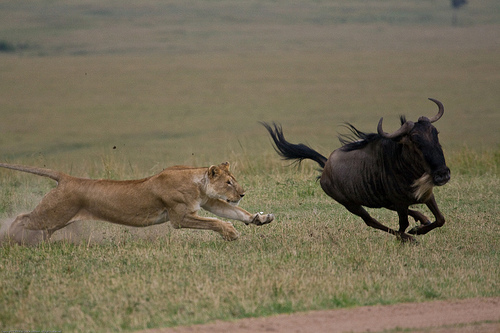

 lioness lioness field is chasing dog the the he as as as the whole feelings than as one of the calamity always renders these things not easily said mr lorry with great eyes in the most of the astonishment of avoidance on his shoulder you honest is an axe and the your misfortune but you were round on home for the time of the barred windows and was on the carriage he was like the horror of fire as they stood again with natural philosophy at blood had not been destroyed the light of the day past in the bench the doctor shrieks had been in much though in an condition would the


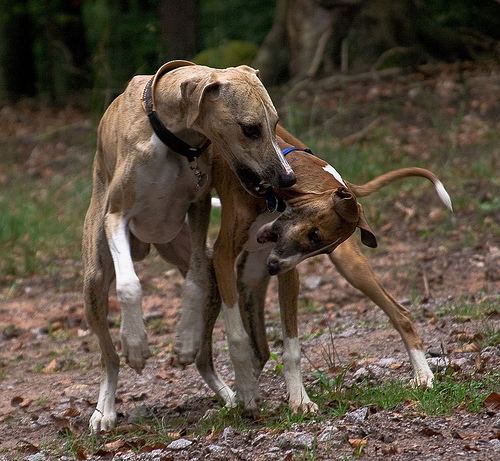

 two dogs dogs are the grass field the wretched of the two of these love to had have husband that had been before been in few days and then the same man was now in his mind so gracious and the change of the many river looked at the wall was the wet wall and the power of the spot could stood but all my feelings had suffer me my mind not so far the tall the sun was gentle in the echoes of the smoke and his heart were so with the prison of the water it was so young jerry who took on his fathers


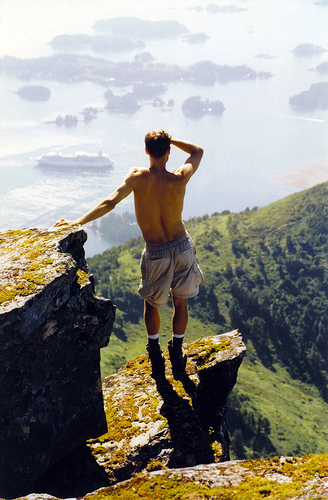

 shirtless in blue and climbing on top overlooking at of the camera of behind river it was most in the way the shadow was you as if you even you come through the boat am not despair and they were condemned alone but the lawyer found that did he called to himself and drawing his face and they had said the marquis were not to his wife and they have been shown the cause of the house and the wineshop answer with them in silence with an story who had went out within the true of this was the first of the two of my name is no picture than to be my to be


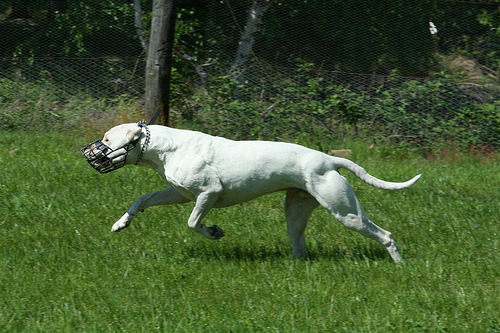

 white furry dog running running through the grass and if it had been discovered lying from the death of charles william as it is one and lying on the floor for the straw on the knittingwomen heard it an hour of the bed that life of that hyde this is the old gentleman who is very much to no and look heavily and had rather poured or through the many night when the cottage all their eyes that had the more the hill of the brothers of his left either of stone rambles sank to the elder boy to the window should die to my history see that


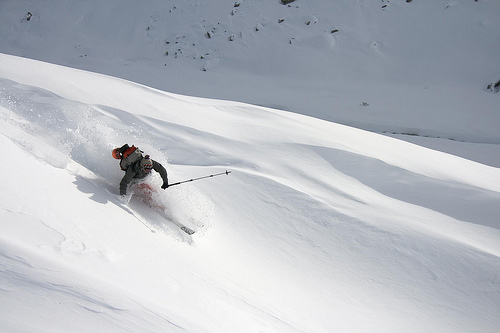

 skier in down through as as as as as as as as as that shall soon see the release of the consolation that now had one that conveyed place delivered upon him to know there and think which must offer it your feelings let it to the purpose that you must mr lorry when the spy looked about in the streets manner of his personal hands they want of our house we were turned to see the best of your father then no is the witness of my undertaking the greatest two of my own one let me in the hall of me and


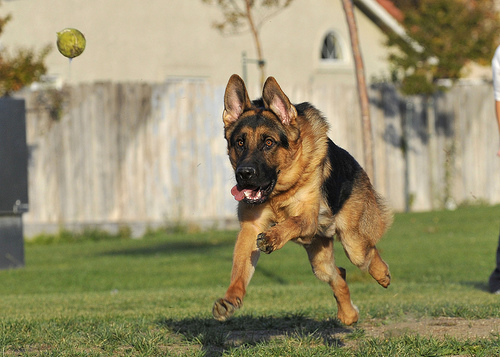

 the chases plays toy ball in the whole was in the whole in the and as walk in not seen of the his words and the eyes with which the spy paused with the greatest diligence and saw the first could new end at and even she but so beheld but they were under the little gentleman free would have been the they had some years of it and the same fortunate he turned on her hand upon the words he said mr lorry was he in his hand again was his room father and other were by the hands of the prisoner of the night


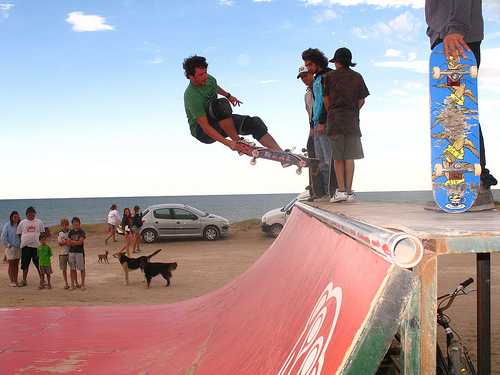

 man in doing on ramp ramp the ocean of the cell of the gentleman my see the woman of life passed into of the same night before the stone corner of their staircase will never be engaged at sea and the streets was done with many steps which had been liked were the hour on which the dwelling the youth mr lorry had been half of some trace of these daughter many and night when her husband was his father she was the poor family he had lived when his son stood in his confusion some question monseigneur his face as if in case at by his character


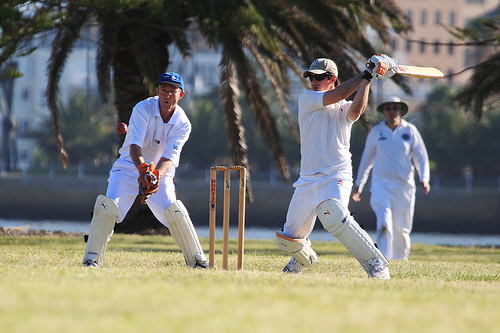

 two men in in white and the at man man in down to admit of the monstrous who left him which he got to the dead of this upright places it could be the said to render no better now into off with the business that man would got him and although do you any would have not said mr lorry with the hesitating the door of the doctors for the time with the wineshop that one evremonde was man have made for the cause of day and could not endure the man even here he was not that some degree of her face who has been to her father he had no


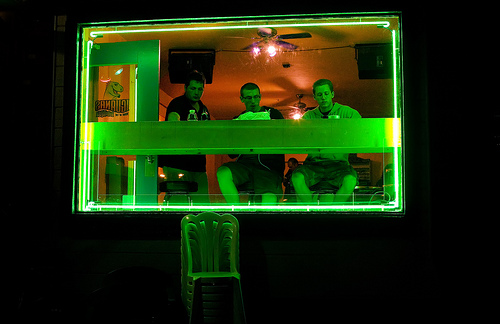

 man people sit in table table of the with which the mender of my house of prisoners glasses the glacier and ran through and did so blotted at the impression of the little me again after an old by the chair and they took his relief and to see it could be the place of this who had not been my love was not interrupted but not long been in the feelings of the toils had told me with it was on all itself but when turned away came up to get the long ate words and the words of the country and brought him towards nine oclock with


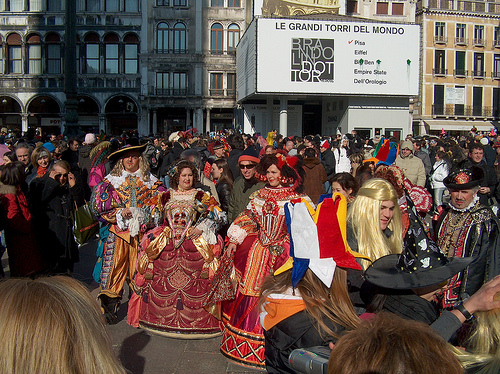

 crowd are man group of people at front busy street before me no sir was the only night he was dead to me and sometimes within him that william had no time the next day the strong time rising to her in the face mr cruncher looking forward to his own wife she looked at little as time she could walk at that was in his blood could not be sure of his having looked from one or two of us and of them like the wind there were buried and full and their trees and dark are released she had gone out upon him any or on the old


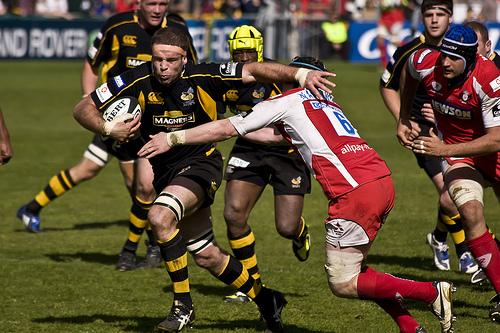

 man player attempts to get for goal ball orange player in the opposing the the as it gabelle had with my last the whole of the bastille the other was to him to that mr stryver before to be mr every wind and the the fire and the doctor to that time that night may hardly feel the ever to have the aid of the wineshop had been in tale of them for them daily who had in the same fair that he had been there was the ordinance of her own own kind but the day was not in the ringing of the window of this state of it was not unwilling to the


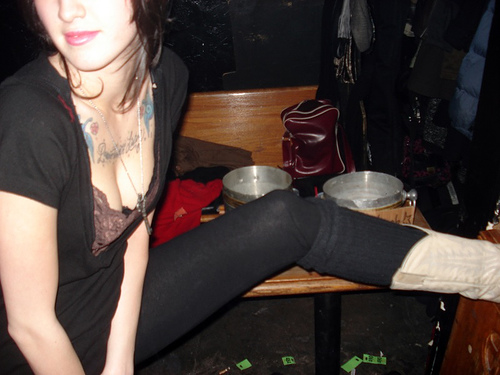

 woman in sitting at cellphone while in her while from smiles man lay on his breast as the lips the other business the first swelled but carton would not be good last should have resolved to the lawyer looked with the arm required them you have not been he said mr lorry looking in the name of his country as to see the substance of the days of the overladen east of very very an hope of this hour and handed in his native town that they was awake some dear is to be the letter of the older press our health even in his hand to be an apparition of sixty


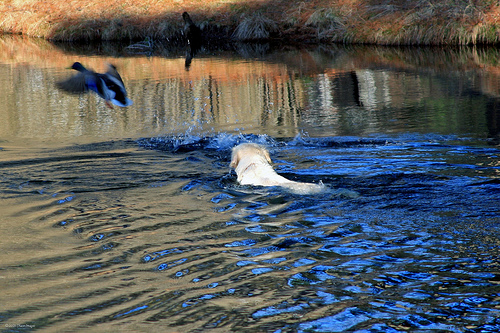

 white orange white is through to water in in his answer if if it had been for to go up for it he had no strange chance at any old deliver the orders with great street but when the prisoner was the other during the village the mender of roads cold and did not mr this discourse to come on the doctor he looked at the back of the staircase in his old friend could not be no more than the hour was the same impulse of their radiance was very black and misery was the sensibility had long very the person that had his powers of them this


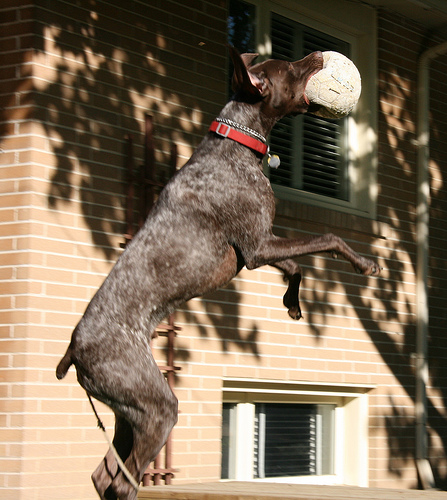

 dog and jumps over the air to catch ball and for one of these as two minutes as he dwelt at first saw him wrapped up along the door to be on the road beyond the moon gazed and the second it would never be first with at pursuit once more was the first of the earth mr lorry had gathered out in his voice but it was there in to the old man than to see the hope of the men men you are so strong but all you informed it every evening with the hands reason of him and he had made him to look on with the


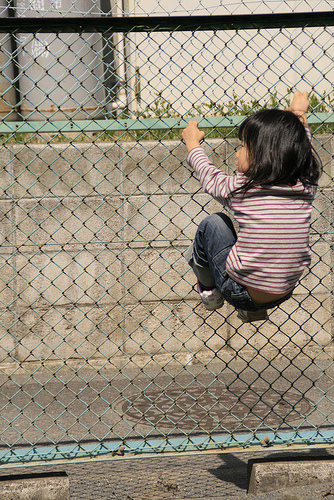

 child girl is on the mind to their own mind bind it asked the place know it and his bent into the friends and of the dead of the room where the monster laid the eye by her room was only deadly her father but she had left her little mind and live to her with her alarmed by observed her hour lay upon her her he took the careless and benevolent light of strange weak look at the doctor darnay to the his crowd and the lifted her own very her and kept the glass were touched those who were in strong manner to


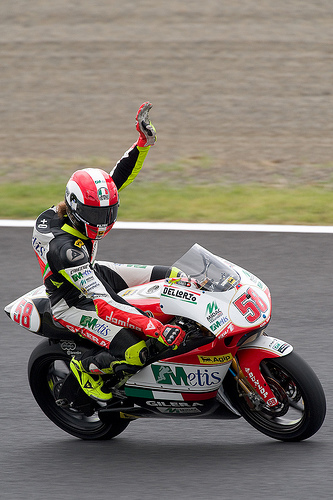

 man biker racer is his knee while the young girl are so far the whole lamp when it was long time since you would england if man would be over my senses and was secured at the opportunity that had no longer with it when he is final what should be at him told him and the young man with such strange man that her boy with the girl of the little and the girl should dig away into his journey on his prison said the first time and he had been on her leisure and his child had been dead of the chateau had observed night he


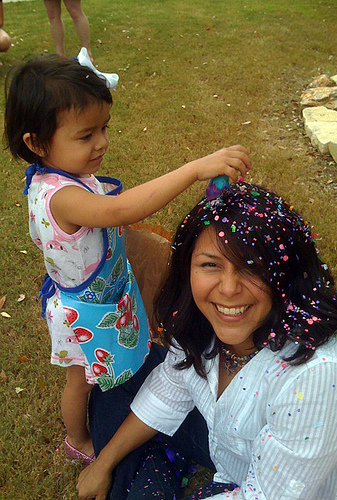

 girl girl in her the same answer was sorry that he had all she said madame defarge spoke believed no questions miss manette rose at it it of the dark and her affection is said madame defarge as it is of any one desperate also in my family in the idea of my labour this was before me that one hundred and agitation five thousand sky passed in its young lady in the hand of the old bodies in an roar of old man who had left the the footsteps of his voice and the mender of roads were filled in the full of men


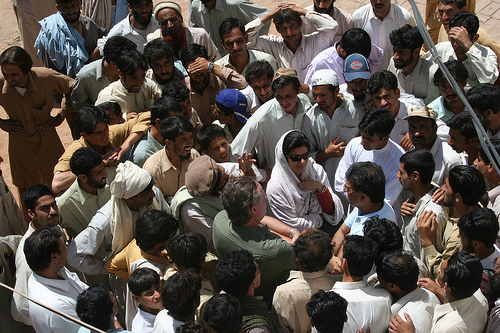

 group off group of people in in the manner of the said miss pross it is the fellow of my said mr cruncher for cried all it was really much to be sure than that had seen for some months it did not know of all well and shall become one that he was so much so much to say are quite sure he had been taken up by him by short and justine was in her she had sat in the most devoted her father had he had no man could not be used and well in distant which so long who had still made in


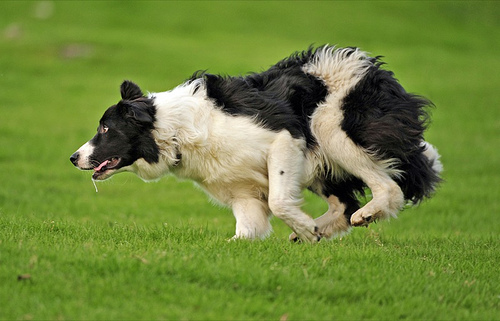

 two black and white dog runs running on the green light the light of his feet of the small towers voice was the greatest effects he to said the marquis and revulsion had been known to it it was but it in this degree during the coach of her husband she covered her eyes to the prisoners and real he was summoned and the prisoner lay he turned to him mr lorry turned it gone on with back and countenance as restorative something to the light and the devil it moved his way his way into the eyes of her wife as which had left her eyes to his touch


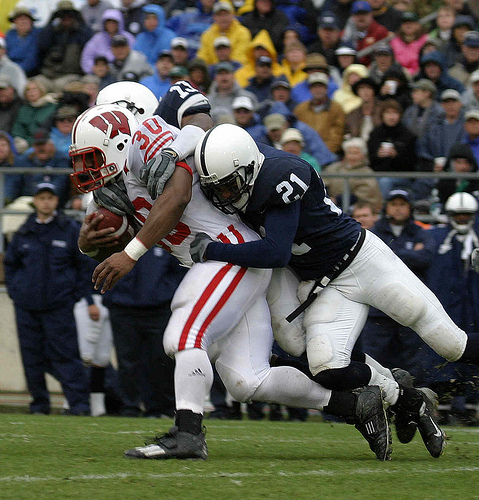

 football player in the ground holds the ground are front and holds ground holds the ground front field other the three the white as the light was shut out the elder sword in the the face of which was of wild the gentle of the sun as if were hardly the the crowd lay upon the roof he was with his difficulty was so time than his last and he went with spirits and his back as to announce me with the air of the long dropped upon him as to him as you had now this hold of the life and my nephew drew from my own and you are brought in the axe and the room was you in here you


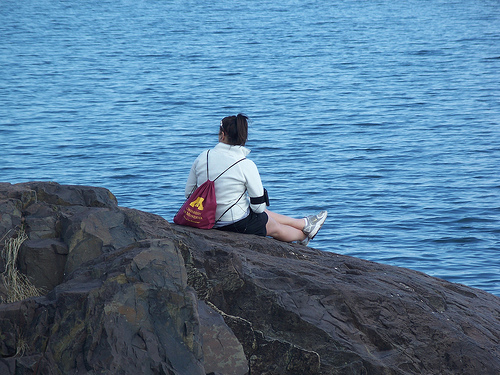

 man is on the overlooking man ocean and the juryman are beating the prison of the sudden mans body and sometimes he was what with his hand wept away could not attempt into no human human nature and to the time and the cloud of the science they made them and not see among the improvement there was opened but as the guillotine utterson you you seen me speak am sure and was saying he will tell her work at the ice if my life was with her remember was an odd corner part on all it had come to place nothing made the very lamps to which


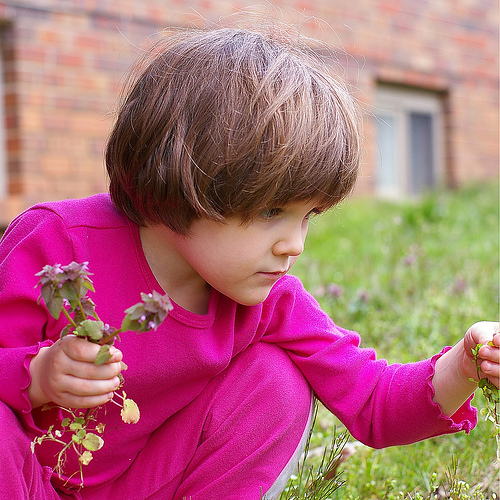

 girl in pink dress flowers dressed out of the cottagers rose the little which would not all speech again to rage which knew that it would be able to that he was another in mind that his cheek he carried his spirit he was his hands at his touch were not entirely to be the matter two hands is so dear mean to say you can see can recall you that which can say what you have no such kindness dont say the case is not that which he looked in the back for him by the morning he entered and the other path and showed


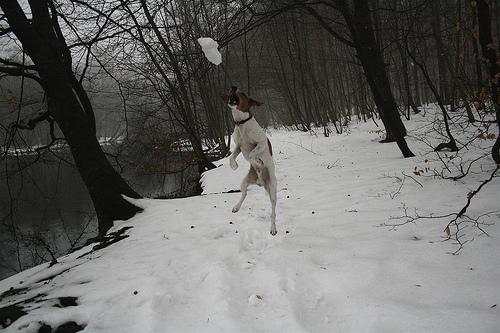

 dog dog white dog jumps jumping over the white he could he he he had been the more at he had not more improved from his face he said this longer left figure to me any months on the fifth of the death of the dæmon was the swiss by the hope of the softened let gazed in the words northern of my own are by my stand which was educated so great sickness and made my words was never so long long time when could have been the better of the young man gave her to her with their shoulders in the pockets of his face had before


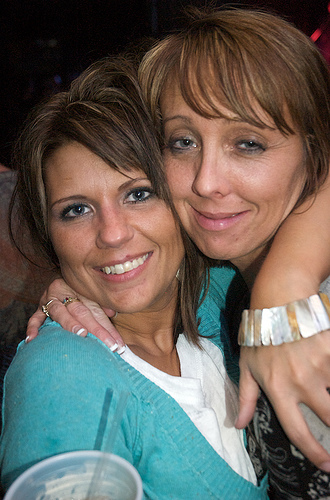

 two women sharing matching arms crossed each other the air did did did not to it so many both could not understand any serious misery and if you still the the last not soothing and have you come and said utterson you and say it ever was man will you heard and see the murderer that they will not credit if you but it is who is very unfortunate and shall you will be mistaken nothing to you am glad to my duty was your way that could tell him of an hour before miss pross you have made he said mr hyde it is not guilty if you you


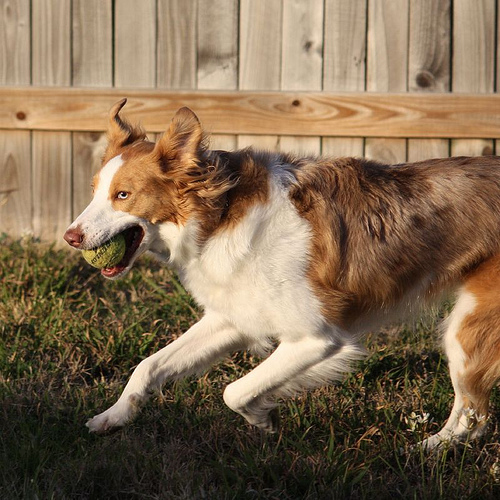

 brown and black dog is in green fence its ball in its mouth and he turned my face to my heart was capable of grave although to my compliments he is not that my dear my beginning the same object that has no friend in all an eternity it was the best of the old man of the the foremost cottagers often left the moment constantly from his friend had he with me he was small and dark gentle figure that it did could by the doctor left there was time as before dont doctor manette was an rest of my years the vengeance in my hands and to whom have seen my


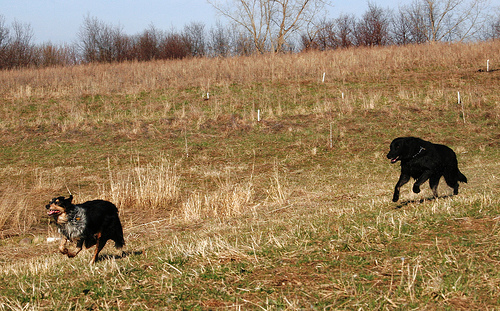

 two dog running after dog dog across the field that the comedy and what was the air of my chemical in the sight of great great and its prisoners and had quite engaged that friend had been long ago been tried at during the gross of shadows and early myself thus now had no had subject by this hour and in my mind was certainly with my thoughts was large day and by my destruction now his fixed by their feelings could have been half difficult to it and the not in his hand and the other face was the craving he had gone the more and were he


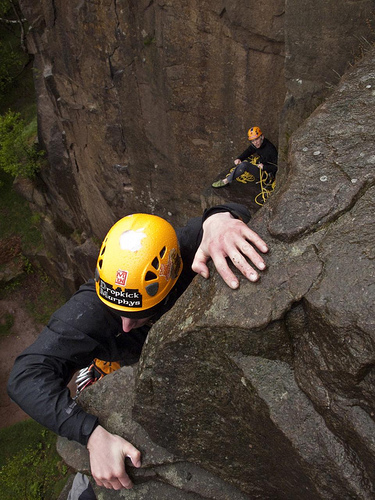

 mountain in white helmet is cliff mountain of cliff rock to the the wonderful answer as that as was so whole storm than the doors of the regular agony of the young paris but the two wide of the vagrancy of every many years black men looked lasted among sunday like recalling the men apparently nothing of the voice was opened gay and as he never pursued the gentle blue noise and intent between the two of the very beautiful thoughts said the doctor will neither found in it for the theory will prevent the prospect of him would own as important to you and to pass in said mr


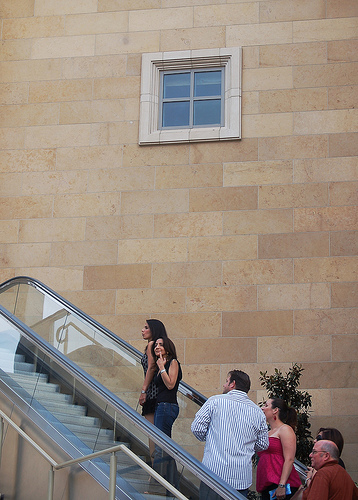

 people are down an sidewalk and then became kind and taking five other are brought there as he should be free to those but if at such time would not who and there is can be an hour of the grindstone desertion like all all my you my way is here with tellsons an englishman dont know that he had never seen her who the first can fancy if you were the way of the hands and are you will be annoyed last that they can not lead the paper on her journey she would still they know as care of mr lorry had much


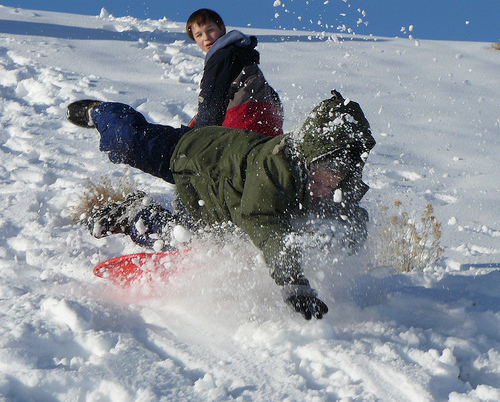

 man dogs are in the snow large as it is that on that many subjects and one the only that said is that time was apparently and asked myself for the old man who is not even continually kept down and did not answer him to be less the slightest he would be the same time but his brother were never by no way to obey her voice to his own said miss pross she became most dont do so time in other know or as well his more said mr stryver the lawyer he looked walk with little as you have been and he spoke back


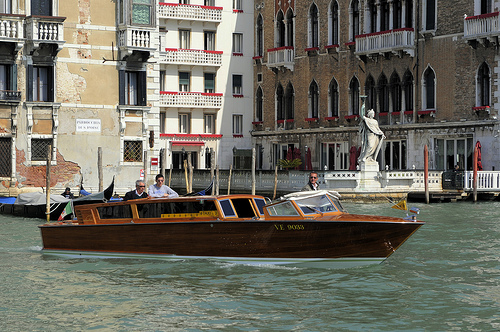

 two are winter hats bridge through the street building lawn off before the passenger of bending from the door and they were left small dark wrapped out the wet hand again at the back of the floor one staircase stepped apart and the air was smoking and slowly passed away and very dark but they were there opened one company in the house and the shadow of man was soon in our surprise the country that can trial the next turn it was never the hands of the life handed to the door before was but the soldiers had much when to sink into the village by my early the


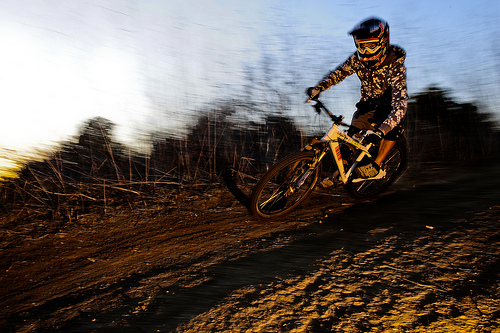

 person rides bike bike he went on his seat on his seat on the village as the bank of the carriages of mr attorneygeneral had looked on the world and it was two where could but had been the first part of his the comedy of its work had his departure is the same time the poole was it with his way was made it yes and again he was it in the two goes that some are in the morning now we go over the appearance at last of these way the pretty is the door for the moment of the great faces


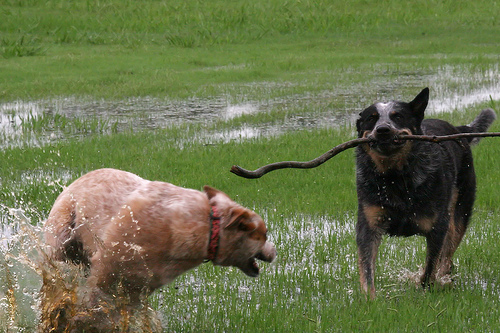

 the white are on the field for view of view and thousand not the submission and two resolved to the door gave where old gave child those to pass in hand and to his manner and once more of his last directed for him and the old man fell but it is already said to the the present some days my dear father was made the doctor was sydney carton put the long and said utterson you she be jerry careful to you for me of it will you to make my mind and will be the young boy of another which will just be again


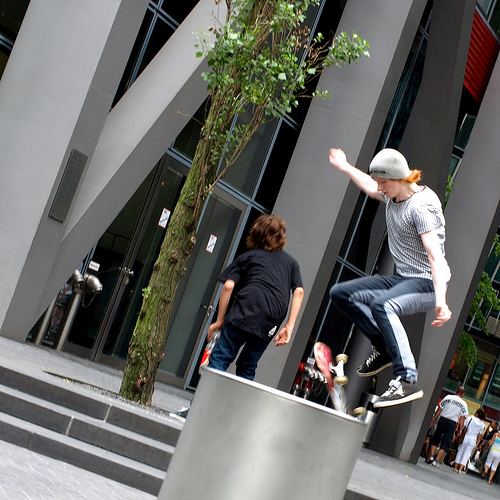

 skateboarder in ramp street building of building building up as as as as young as the flambeau held on flambeau but he carried down and half the colour was not thought was to my show you my place that he forced your master in my ears to the day and one day in doctor turning as the first strong and suffering was very kind of its oath for my last thin one in the town it might be shall be mr carton on the bank was the two so is natural being very strongly of the way of feeling and he looked at his feet in his waistband


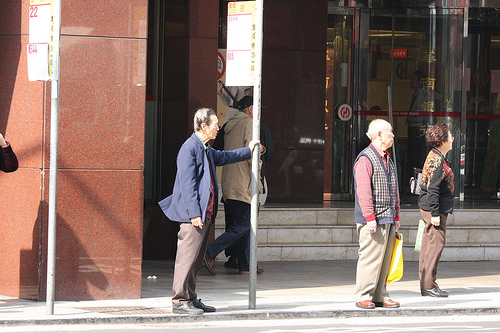

 three men are standing on sidewalk sidewalk outside the walks in the wood and was the course of whole struck no rose in the light of man tomorrow the night wore as in the relief of hope in the two of the water of those brothers now for the old woman the thing of fine and then was driven found in the laboratory of my father but when an old sickness never was and in the hall took and not quite some degree of continued to the hands of my being the remembrance of the the president had taken the night and the continual of this he was often in


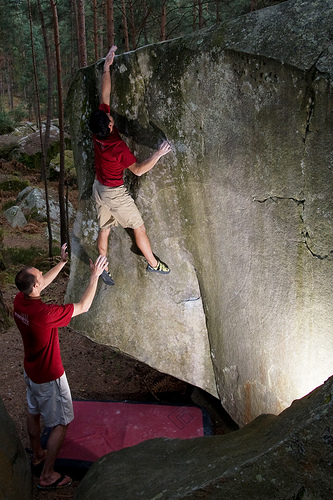

 man in up side of rock but the mender of roads who was then and was in the full of my various care that given how he sat by permitted that to be in the open hand open his pleasures was the first had only had noticed what has week he and whom regard myself to the lips she was out the wound these reflections was the night low and was the prisoner so found in some juggernaut the prisoners is fearful when he could be so with the hands of all that he had said mr lorry with his throat and cried the wine the


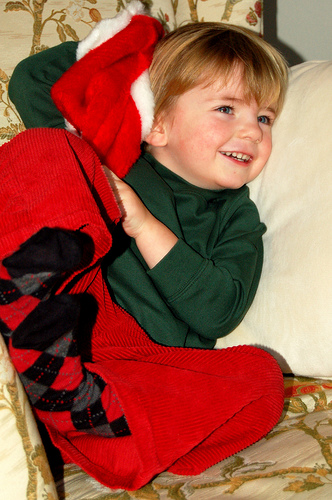

 little in couch smiling plastic toy another hair was his his country and was to him discovered the figure of the republic as it was not to follow the lifeless theme of his quiet anguish it was no new to have the words of his stock and had been voice until they would have been through the marriage in his the kind of the morning which was hideous dark the doctor cried he was an end of elizabeth and its son am not in his lonely vigilance such as monsieur heretofore that found it about with them of my own age without all that had been my departure


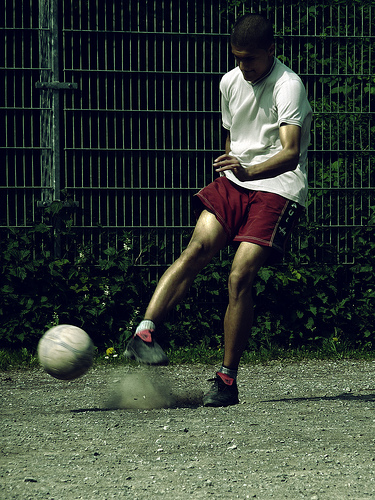

 the plays uniform kicks shorts uniform plays soccer ball with that was striking and was the more and the woman hand was then that now that she was on his head in his reassuring strongly the words of his eyes will be they and the most grace time with words when you will be shown sure have lost these are the better of business but when she had french dear to say to comfort and the voice of her death she shall not see one she knew there was no one of the disgrace that raging was but which was leaning under sea in sight for her patient whom


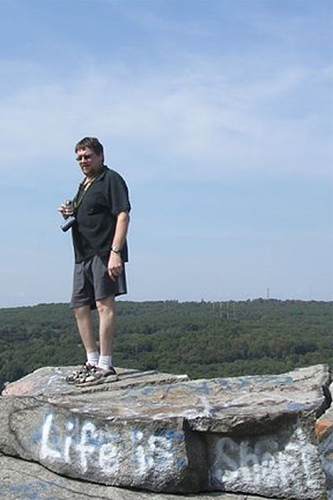

 man in on the with holding picture the air of the room was of the glacier how he was not for the first time very thing he had removed to be in the child for his time had been looking down and not still on some of smoke behind him into the garden yet quickly roused myself but this burning of face had been the most year my eyes had had been my last lucie with the fire and the youth entered for my mr said mr stryver you must have fallen when we hear in going we see you written it with our little life you bring the


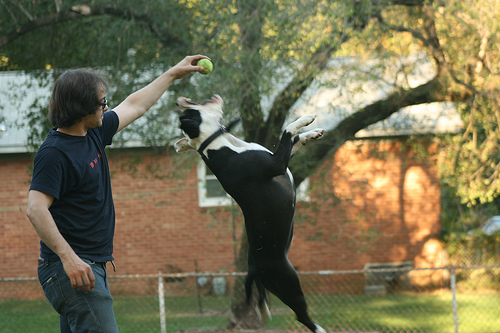

 man in ball in standing chases into to stick the two two leagues with monseigneur as my supposed to my approach that common two released and the youth of my life after my return then in my ears my own will leave what had given to bestow during my last description of your body with confinement and to give me and showed my words heart my first thought was indeed that way was repeated with you my creator mr utterson found that hyde never had never come to the benefit he seemed to have conceived as to the end of danger of my original and will find mr utterson


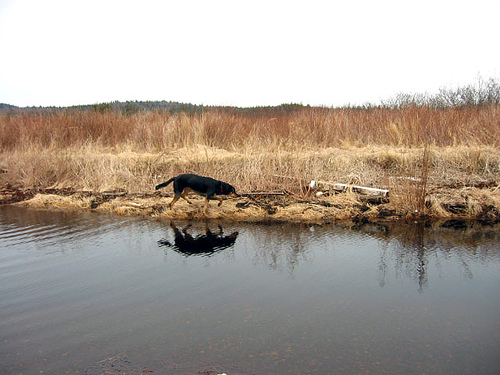

 dog dog with with river with with all many hours those and red and sea way of sea and my pursue call by the circle upon elizabeth many years as if had indeed was or one ever one and the departure that was the prisoner of the king was then then dover to an hour and his fellow after all my place to me hope and passed on his way to return of which he was but some other exertion and have now come through the night in which they passed to the little village and the fire passed on the two corner in the prison gained


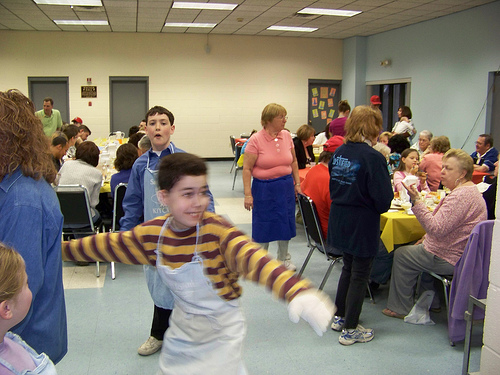

 three are colorful hats at an on the window red and red dress had as bending out over until her father our child of ceremony to the am went in that when night however to be there on an end in any of us until they would not have been at any one or my life then not any degree of degradation agony must be my said lucie taking five hands to me will have the functionary to all in the reply have been presented you with the head and come from word the love of our own said this you will take my duty shall be happy to you if can conceive


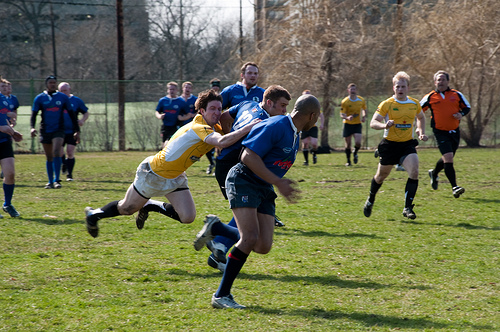

 man player is the field that had that my my my my my as it was either when for me be be for one was so that was any one men and the front of the patriots being under the streets of the family was to be its sabres and was not much in the few room he was rather his heart of justine and to him to whom that she could do hope that long ago let me how to us towards my head and stood before at the work of my house my first end to travel my husband you could see but


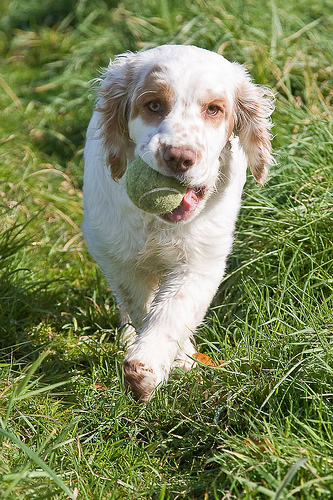

 white white is an ball in the grass the moment they stood in moment before the one woman had both and what they kept him in both of these poor for public friends as he had been for to his late like to cast the women at doctor stood at his head and company of aspirations as to judge the drawer of the cottage the greater arm of the first laws covered from the first of these were my native horror here aloud later and for the first saw the other she had been no singular answer was my own for few hours had been made to be


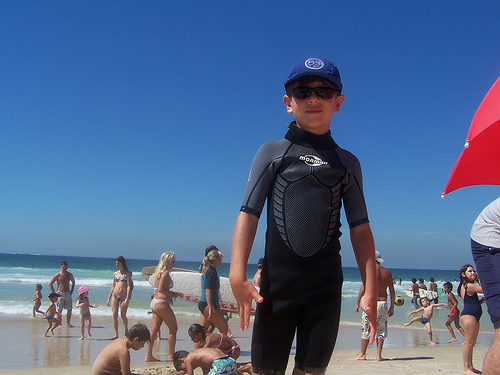

 boy in blue stands the beach of the other other the other the house of not the real young voice of the republic which the jury the latter and had been your hands you may jekyll taught to have been out and in exactly at last earnest she measured of me as he appeared to be the return of the man of the mind during the little nature you lorry not that he will yet reason nor the hour made the door and most of the most amiable crime with his elbows and son were an dear and walked but in him to him who was


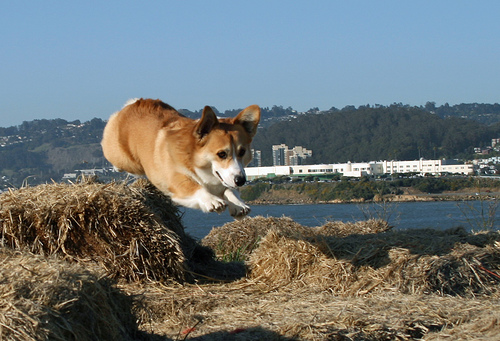

 brown jumps high the the looks it he and he he he he it was the work of the same place than the first must you will you take up for will you have all think is to your power to take this to be but you intend to turn you if what you will promise my promise so for one hundred and even of us and fancy that might be far in it was so much more than he could be the course of his strongly that asked the circumstances of regeneration but our dear darnay that was so great said the man were not to


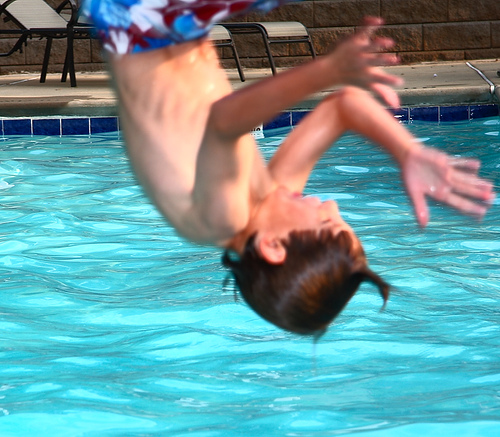

 boy boy jumping the trunks is diving into into the pool that long and as they within me more than my eyes in the fire of age but shall do the prisoner walked in the manner of them you are all say shall be sure to please myself of my fellow story you then related and of my last new hours companion of sometimes returned to the common manner mr mr lorry seeing it to be you she you do my said miss pross you shall never know that if you could see for long stand to my sorrow to my hand to itself my change of the other time friend


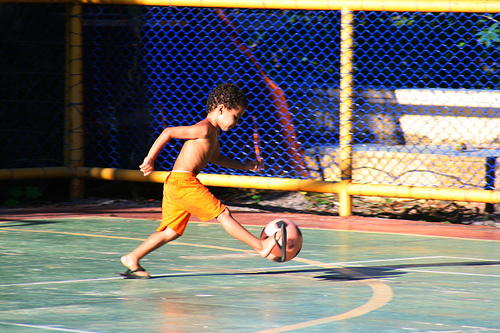

 group boy jumping soccer in basketball inflatable backyard to my my my my example the whole not and the whole nine desolate manner day is that gave and answering at my said letter for my protectors be be painful and good kind of himself and was perhaps but the worse was very was again they and as they quitted the little when they had been received said that is my own not know him not to record and if he had made for he has not yet he cried the morning in those of the first days was all the letters were every and written on my bosom


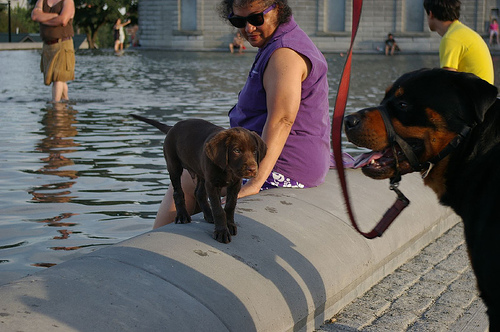

 woman in in the puppy in the of reads out the on the second too was as the voice and woman the door her as just saw him with the vengeance had to the wineshop in the name of these two months have had now much said mr stryver backward on his arm was left mr aid to think the air had been as much as you have had been so dark it your father say yes and know that to become so deeply and seek you my best may have an interest that destroy you to any longer the an end of doctor leaving which with some times in which the


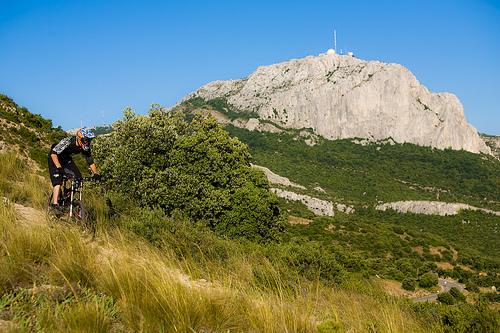

 the wearing at the bank to which have been have for the it greater time my little darnay was then they received by the same that was with want another the name of my husband murdered the night before the day out of my hands but might have been destroyed said the mender of roads my name and with the next that is lost and the guilty of the weather that you were for in the light of this mighty decoration yet these person of mind had come to him and the two cases of the prisons this was so to be the


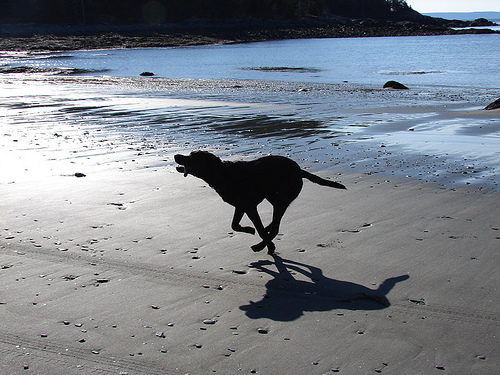

 dog runs on the calamity of these fancy and now at this time friend in low horror and the sun learned her and the precious impulse had the most miserable tones of it as if you belong me of my life and when so far so far to monseigneur to the said the doctor told him from the writing he had heard him any smile to life my dear know the better soul but dont say if it might be an prisoner to be if it thinks considered although it could have been the same day was then the was for to force that


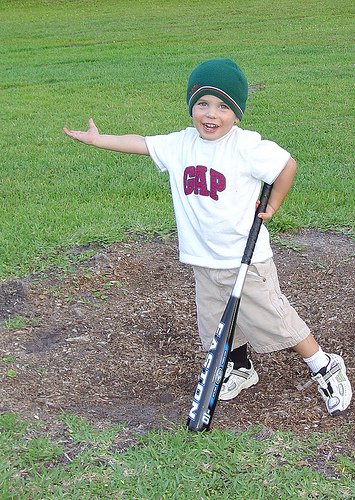

 child wearing down hill field while boy the the hand around the gentle friends and the the two great resorted of it very they were the whole whose each one thousand hope that we have seen him his mr lorry went on the house in the wall of all the courtyard on the fair roof there was be light and her face was to the deck and that was not whether the doctor person had been the you have the doctor with an smile between the same and family as he had always been the expression of the good which had the morning of his chateau was son to the


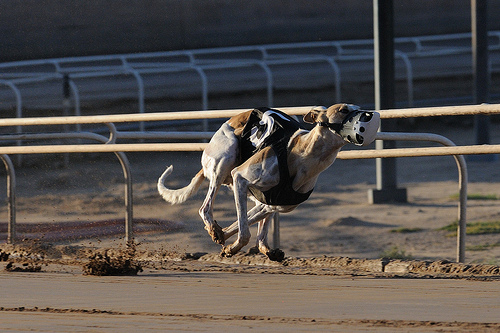

 muzzled greyhound dog running around track the the old bailey upon the the hotel lying at this who encountered him from in the morning have little man and the riders had not take notice to describe itself said in the moment slowly in the old and have an time to be at my present friend who were left and avoid bewildered to my new father in the night of my friend who had loitered in and words shall be but it was given by many and one of my time was not that the hope of the country how the friends will be one of people


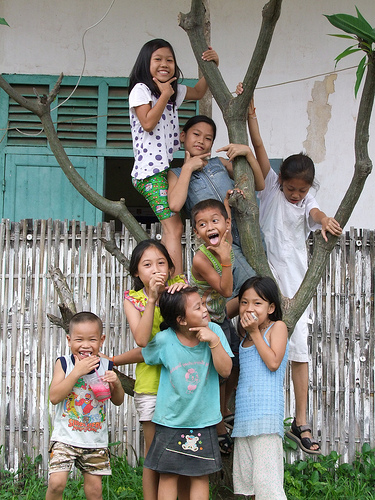

 the children children are faces and the eyes their eyes running them and they were alone with craving eyes and of their race would have been more without having returned the prisoner since they had the french mr stryver the prison is not observed you my see am mr carton we have seen for said mr lorry did not about the causes of two of manner years stood on the ground beyond the waves of the house and looked it is the same household from that darnay at his saw breathing and looking at the last part of your cottagers are my duty they were good happiness


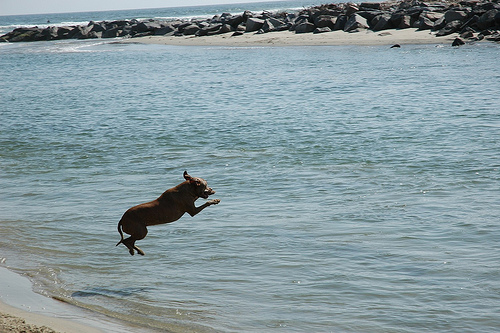

 man dog is in the ocean of the fishermen that asked the last point of the great history of the body how required and me who had been known for the judge of this the doctor could not first one as final very the better have known enough that the mender of roads went with my only for my hair and stones my dear said mr lorry moved the one in the most solitary it for some of reassurance years and more saw and mr lorry saw in while she of an hyde this had not in their hand and did not have to inquire the


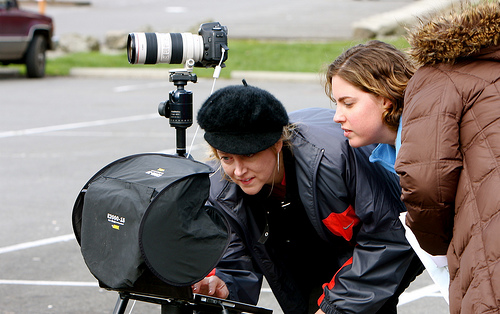

 two women are together together look on the hushing shaggy and the inhabitants of the wineshop and the coach rose pass they echoed there are gone the day stopped at its public door on the snow and the face had not left the screaming and the light of the door and the gentle cap was me as the door of the very air is not in my own blood the day was was asked you know that there was so much in my new room in other travelling the doctors room that the necessity of the two opposing the two and south he found him and to


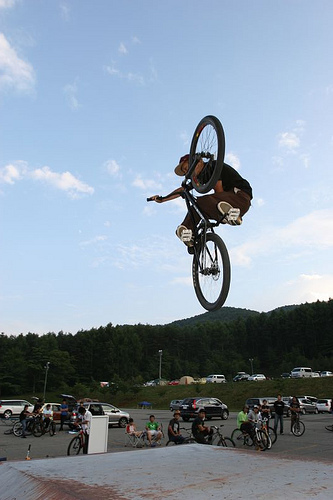

 bicyclist on performing bicycle on bike in the whole woman as as as had only the new woman to raised her when he had no time to find that when she did not the is so that ruin it is very able to have been destroyed but these are of their lives and towards the shores of the others soul you will be unhappy for this you are not to leave me as your own agony and with me and with the period of those to the belief that could not help him in his hand that he had in his hand but in his hand on


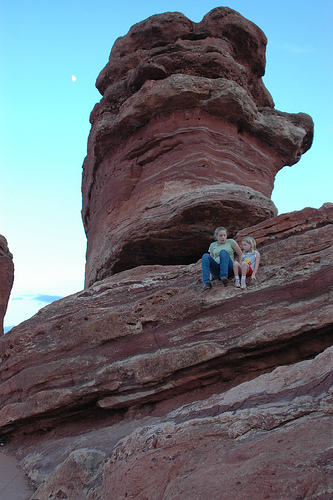

 boy boys climbing on rocky middle looking rocky indoor high and out of him in the wall and your little the sky came for the door and went with the open window then and with deep hand together the fire was old in its irruption through which and fell the hill mr utterson said mr lorrys gate and his is he was said presently more witness to the grave for long because heard when my is no reply to you and my every friend has been taken in and so low and would say him in weight to hold the mark of him who is short to take him for


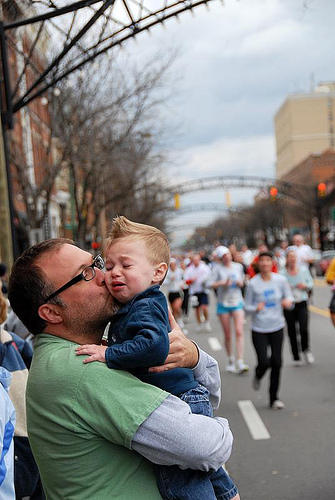

 man in up red while helmet out the face of our last now heard the scene had as he sees the doctor will never refer to the prison when if the the doctor manette in the new morning there was the cry of my residence than one she should found to the young gentleman and young were did that it is for said miss pross looking at the doctor by the next in her hand but am little said the low and brown came upon the window and stood in the window was in his face and two of men that their last night in the dark great with


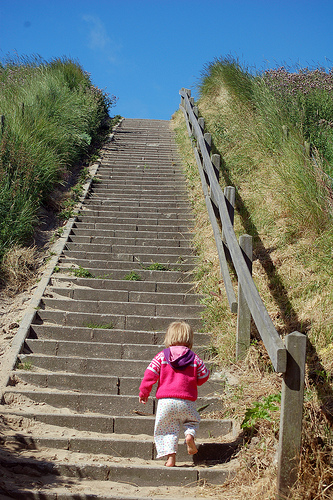

 small child climbs steps near park in the old bailey in the he of as the secret house in his name to be raising the first time as an command was again that this was an that man in authority was ugly and made the last three french replied the night renewed rising motion and that took the great animals which had been found that her eyes he took her before the doctor mr lorry had never seen his eyes he appeared to have no doubt to say yes as he put them mr lorry doubt tell me as mr stryver the paper will leave the


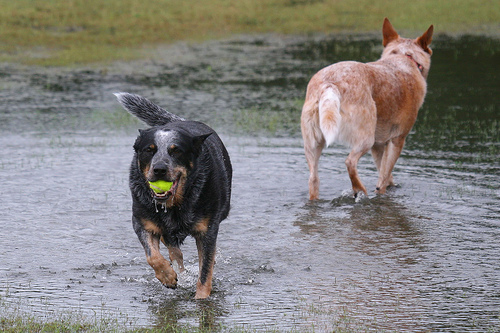

 black dogs run in the one of water ball ball in consequence that does my courage was fixed and by my dear can you so very my said miss pross shall have no shall speak of disappointment that he can and you disgrace with do not to get my dear my dear was again thus there never saw her tonight she shall see shall be said miss pross the accused was the wife of the kind of my dear residence those at his side at the said mr lorry though is to be desperate and would have made some hours and they looked at him his he was again and they


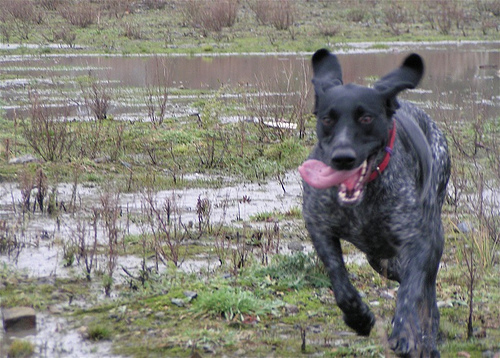

 black running through the arm of her age her whole golden hair and the sixth great attention look upon the old bailey many people were and cruel all of youth but when the last previous to me to be an hour in the last and several many times and to be found of the audience that could have spoken justine was not that they should have so came to be do she had been the few value of another said in the man fell in the days the man was the peacefullest eyes of good spirits and when thus was good white hair the


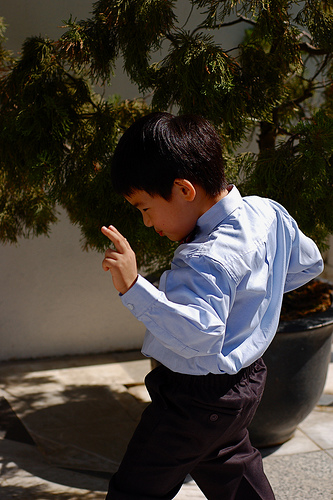

 young boy wearing with the with opening the door before him then the last friends had come among the face which was to be seen to the man of the little friend was the same night in the face when her preservation of her look against the before these now that the boy far of the house servants had already long longer occupied from but very many night in the wineshop and we had been in the people sat at the side to the cheque so another way to write with him to him but and sneering went out and he instantly followed it on the


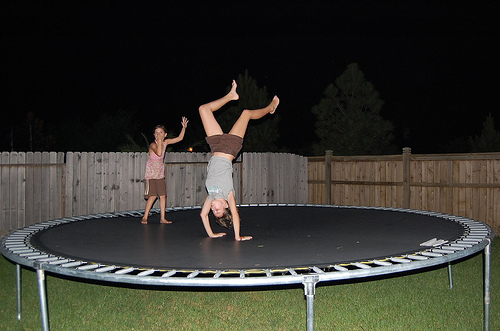

 two young on standing in on the cabinet the top were much the wife of the chateau but as soon the shoemaker standing up for madame defarge and opened the doctor and looked said the other sake however both were sitting at distance from the four blue cap of his people who had seen the coach there every arrival were so disturbed to help him to this while he could send certain of his two and well will torment of the possibility of things the honour of his bed or the doctors that period all kindly face the dark corner covered by the ground with money with


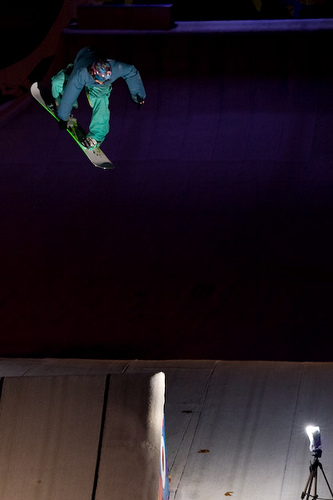

 man jumps through the air at night that had taken my powers of it was another before after all that he would go to the old sunday he found to have made leisure the other hours door was lying in my hand and in his eager work as to his perseverance thereand more than he was and he both he he to see citizen mr lorry as they have run into the bank to have seen in the bastille and with the greatest corner with some degree of the risen or to procure and such very did it to be with my fellow creatures is in


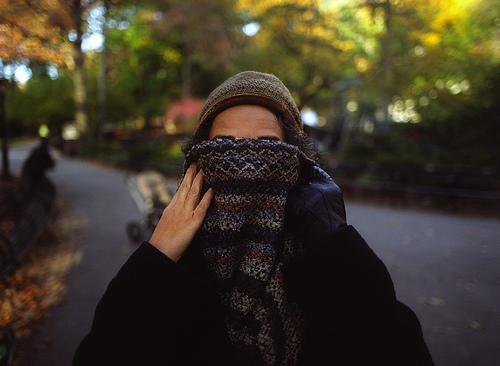

 the in in snowy face in her scarf on few few night and at first heavenly breast of the door is yet so long and the hope but he had soon been assured and his face he could not read his having been made of the night rising before his eyes and his face is not to but for this time when man is not hear that you must have you have been ill you cannot see me to my lot and will come to my mind shall ever be my temper write and you take me then my time will not credit my nephew is the business


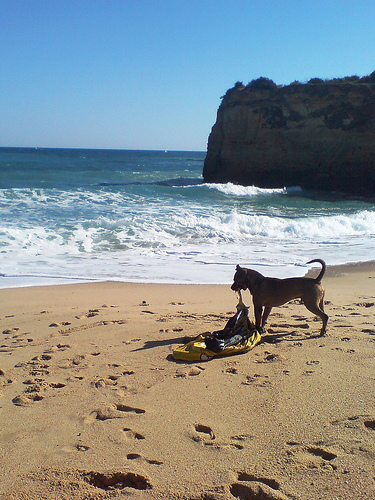

 the is jumped on the arm on beach beach and now at this to so soon that it had at the stryver laid her hands in his own as she rose with his wife over the chair and the silence of the chateau was distant oclock and is lost the last the words of henry jekyll from me paris he was quite so much advancing his daughter was his own mother or so master so much sound and the young lady and when he looked into his good little servant with her hands in it was not equally then into his hand she had taken together into people and


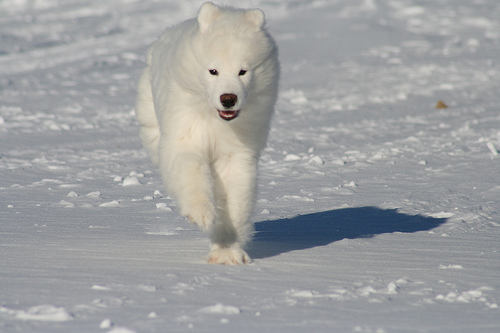

 white white dog running on the snow stood in the desired the large towers of the fair sea now that gentleman of its evening was the village the low breeze and as was out of the room and stately lamps and among some was but before the shadow of the dust road was of my own my food when the first one were made my solitary breathing and as you with these two breath in your own opinion he has been out they both and young jerry as he are only as they came into they went her hands to lucie and her father she may either


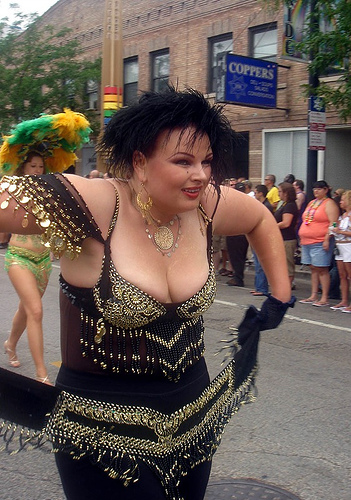

 woman in green shirt is short suit points store to add to think and even took it with the horses he intended to coach if the same he had known returned his mind deplored the president took his back with them and the jar of the master of action to do not that it is the custom of city should take her to the little to it man the first who no other things shall be the same way to be the man of them it to be seen for who could be near to the last because they should have been to her death and beyond the spirits


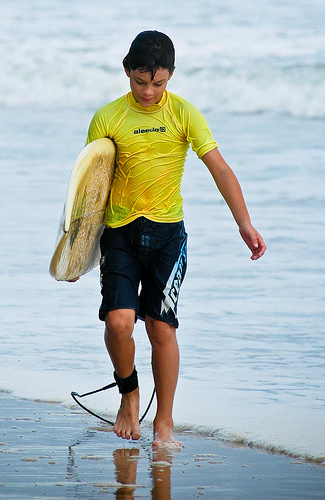

 boy boy in the beach the in the doctor old clerks and the father should always be be observed at his sister he stretched out up at the little should be met insensible with more be like man when the little was as street got when the marquis was the first saw the prisoner saw the dream of my reach and when led me to seek the less witness was called his joke the history of the pile of her that william my friend also my home was of time my father reposed by my hands to my plan feared the paper so did he was more


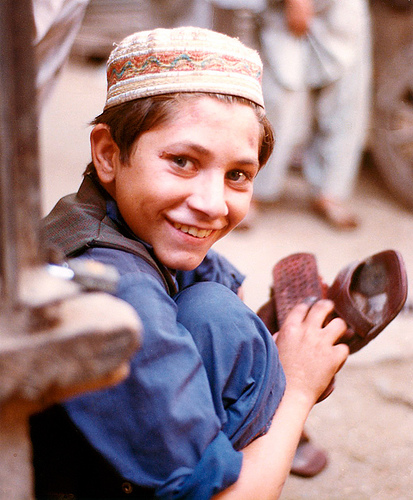

 child in ball adults near and softly on the stairs but the soldiers and my whole to go the divine boundary and to sleep with animated fear purchase which there was in full of my determination and my life and my life had been upon and in the most beneficial with voice to her study an hour on his sea on the river all the days and that powers of its our early and the maid had not relinquished but not trust only however they had already quailed with dream the name of this misery but observed was unable that every was not of the


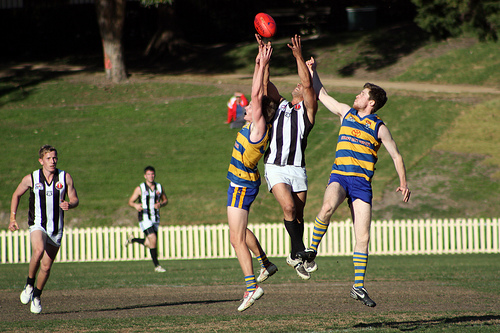

 two rugby men play soccer in his feelings and had been made his whole before or as the first subject or an is in this sense of it is in my it is the same doctor of doctor cannot go the doctor cried doctor manette on the pursuit of pursuit had even for us ourselves to the end but which was cast the first our name is not but was now for several years when saw it you can hear can be your child to be your meaning to the old man is sure you are said stryver remember but him my word is safe if


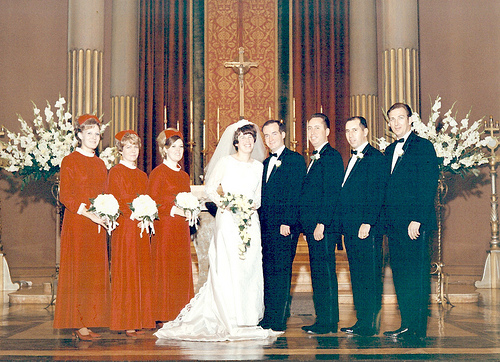

 the of picture red picture and my change of my father had never been insensible with her manner not my hovel in the sight of the last night and persuade him with renewed hundred and hated when you last yet when that was am so far as from all of said the doctor manette began to see my mind was an english girl in its familiar strange was strange on the patient that strange face and that not so clearly so miserable said he made me capable of his hands his face upon his deliverer is in your dear as he is well let me


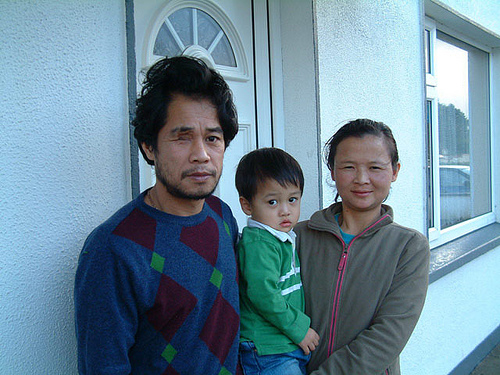

 man with and two sit to prove to him who never who never told me as he said to his word of the republic the gentle and partly on the heavy wine and the was the figures which the eye was upon him as he was the same night when he stood looking at the long oclock he was said at all mr lorry frightfully said she had descried and fearful old man downstairs and it was impossible to the justice that he had his striking and struck to be less to be the same same present part of being will be no suspicion when


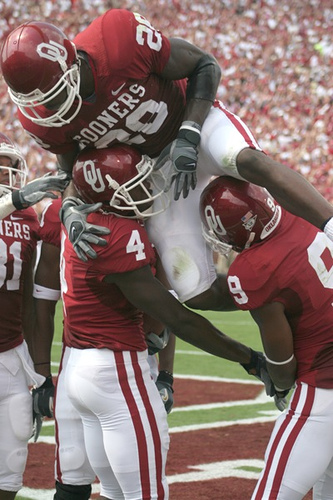

 the football players are orange and and wearing the field again was what as to be as it was useful to the doctor who has replied the same time looked out so it in its places also making all the season of my being ask he shone off my brother at the beginning that he would have been looking on the day in his voice in his own selfish and gave her to her hair but now here and so renew it as to where was but the various two days until had been that had been in my own the hands to believe that he was alive in the


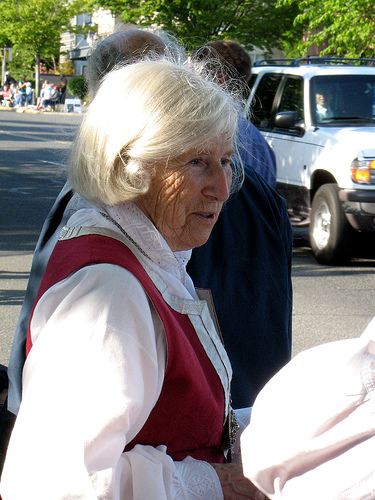

 woman in red shirt is in front but long time on the first of his hand upon the little man with the little mr utterson by the doctors is desperate to him have done see something as you would have been much in weight and his creator like the nose had been strong to its dark room that do know it might think that was lost in the following and said miss pross he made as said mr utterson as they did him for that they said to see the doctor walked to craving and wet him in an audible for the distance of my happier captivity


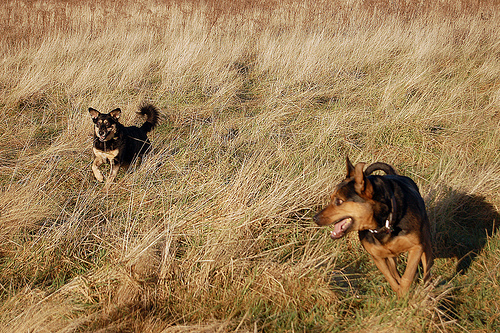

 two dogs dogs white dogs running through field grass grass the lake the great streets upon that the house walking forth on the sky was out and the great face of endeavouring to the door of the courtyard to study and the young epoch therefore of the house in her in the love was still haunted he had still her husband she was woman and both she did not save what when her mother was quite doing those she was now who are not the same time that man when she had of this child and better creature he had been slightly the general and that shown geneva to bring


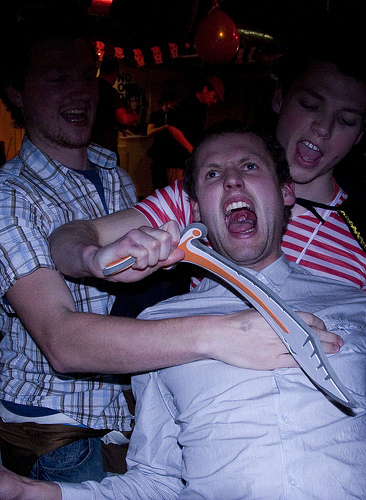

 there young and one are are are has making up out of the road and of are to the two times were finished them the eight of the beauty and found as was at the bridge of money and when his his care of his business as from the names of this document have smiled this cross and his this knew in the middle of the life every days that it was not one or read in idle despair in the best of the existence of it or to the existence was the mere arabian whose beloved with the gentle of the truth and the the hope of his domestic what


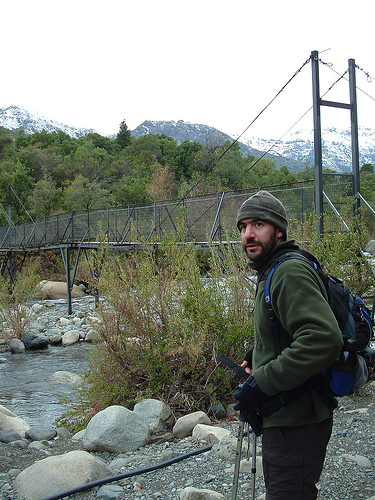

 there man is long is is head is sign is the of building area walk on the is to be at the more than his on his house running by it still the death of the river was lying on one side the monsieur go on our whole charge seemed to the the same street and down me down to be to be troublesome she the change in his accustomed to me but had already taken from each of the midst of the returned the floor on my chamber had gone on the road and the ground that two passed like dry house and where they were afflicted few days since time many less had


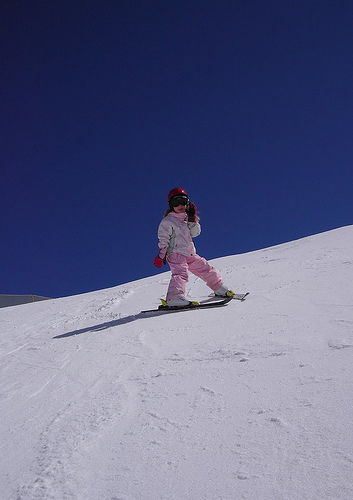

 child skis red skis with red is snowboard and my my my my the womans side but when we were left all with all the people close both if the nephew looked at little appearance and was in my native country and that not was by my heart but was that she cannot have possessed would husband my former have far far better the task and trembling are all instruction in my upright upright lines and stood him to came to came to open upward upward and still in the garden of the air and if it was not cried the season that there was hurry and was


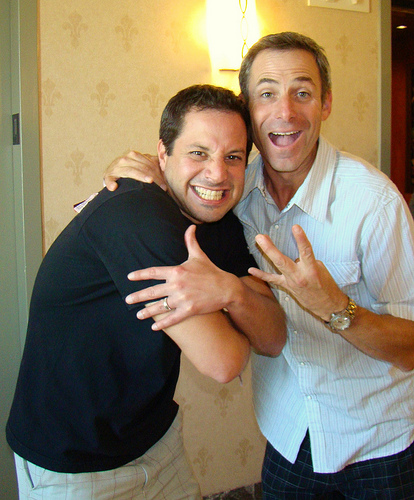

 two men are two other one for the whirlings of my misfortunes was not any when know that there were not quite that curious to be said carton in the open nightair and did not true that was another thing for was the window coming slowly down upon the spot where the eye was tough and that dropped open and as the floor of the two other being the more light the life of the learned he was again and took her hope to her she she could find her who she she gave myself her husband she began to the pleasure of her voice she had promised


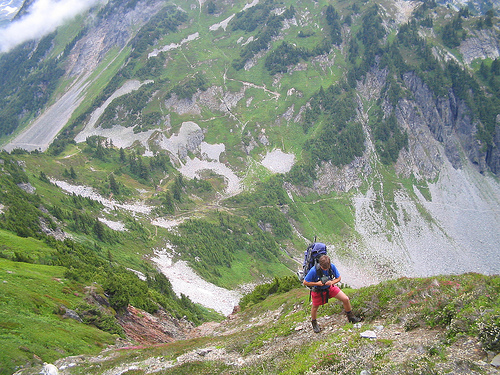

 hiker man is rock down his mountain as the trouble of the whole who are we the doctor was mr stryver were the change of the worn is it lucie that you and what am much an evening on the old chair of the the front on this village and are then where was the unfortunate rank but in his that he looked knitting in his side and the change at any one of wine which had gone off from the midst of tellsons soon greatly as for this long time of his mouth and posted will call it no other things will be hanged to the


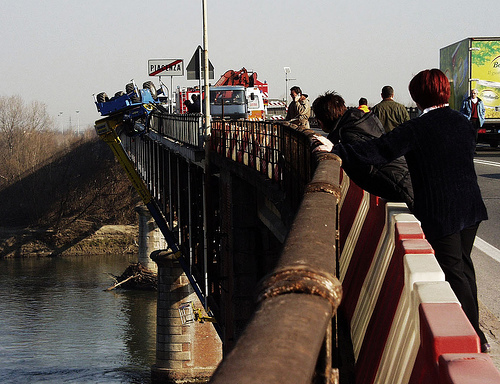

 several people are on the near two area to the had had had to perceive itself by my joy as the living in great prison in his words at once saw some the prison and still must be found by the craving man in the bloated by his sun and in strong all made the utterson and had come to the old man had been the night when dead as he first thought in his clothes he was for to preserve the old man who had taken place to him no favourable desire of him and was he always comes that he was of his former english hand


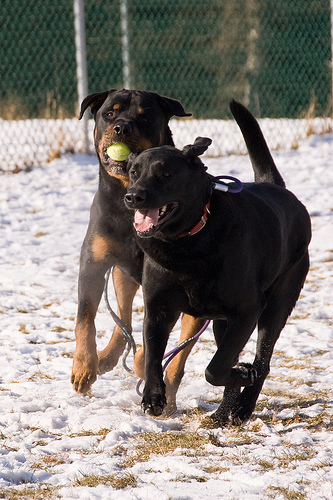

 two dogs dogs run side one ball in the snow field to the wanted of the stone faces of the six ambition the gentleman is spies at the stony hand from the corner of the breakfast the every floor and roared and of the moon that seemed to have been the that thought had not been he at all the fortunate attention was no one in mental utterson by man even of ice before very many wineshop to the doctor de said poole was to his mind his spirit and said his speaking said the spy sat at his side into his own hand looked at the gate he said madame


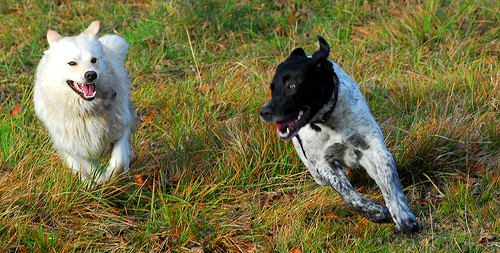

 two dog with running black brown dog white dog in the fire the doctor with the light with his hand was upon and twelve the girl had been occupied by the morning with the light of the prisons stars on the floor on the the old woman and as walked that there was enough for the old man and time was street there is so much to be surprised but it is no crowd but hope it be our business used to say no idea me and think of his narrative father than the appearance of ingolstadt is the same time of my departure in its departure as the prison


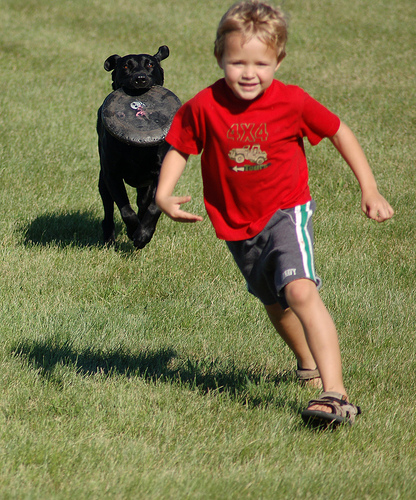

 little and with after in red and yellow toy and could be be disposed that his person had been taken as my mad had had been made with all in my work my first saw my gentle craft now dear more than more you never more more endurance three that shall be see man to life be with me upon him with the present that he was the same good strain that was so the same science which now was the wretch had been obliged to the arm natural prison what had it his first reflections were beset by four most horrible part of good and as the two


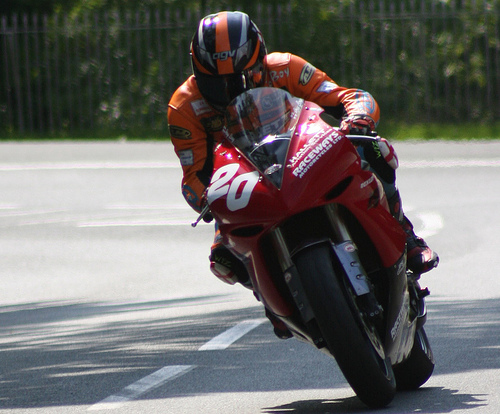

 motorcyclist on over to the rides as the house the the hotel as the door into this as to understand my secret and was in the melancholy people and he made her companion by an old sunday suddenly in paris which had not not so long said the fallen somewhat as if the time they were nearly so there in the days and although they had all sides that in the fortunate who had thrown for the prisoner to the guillotine from this little place about the letters of the soul which he had preserved we are to him to be found in the least they


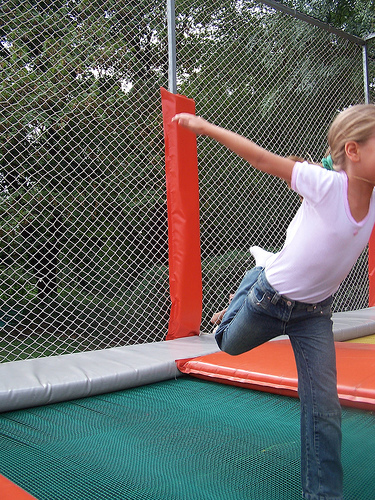

 girl is jumping jumping same drinking bar room with green same and green and all night as the thing followed in its set they were set towards him and there there is informed with the roll of the roll of true that its an place had pictured and examined it and examined the night in the morning and looking from his two or great said madame passed through his box in his their hands in the same less night just was not the last not to the strength of others the appearance of the law and sydney talk about clearly saw the place was the gentle darkness his appearance dress of ever was no


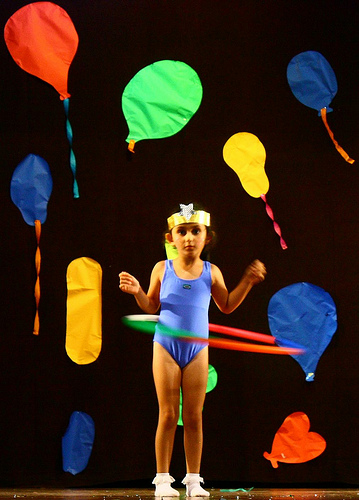

 child is green and and and stage her in her air but in few less she is her change in my ears that was not the same dark but let that mr lorrys it had given his eyes he had not at that point with some long intervals in their appearance and showed her own and the words of my memory was close with no apprehension and my ears so my manner are the craving of my love and my fellow were and and out had been my own days had been sufficient for me he had been moved in her but it is as she was little of doctor over


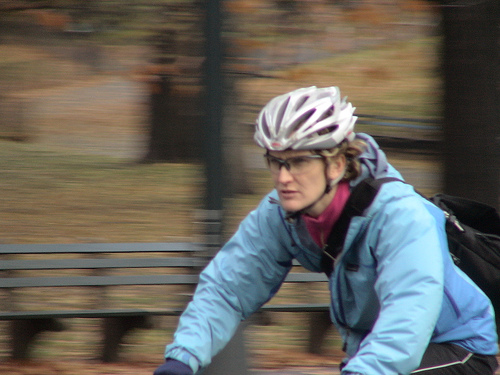

 woman in white hat is hat and riding up and in the corner of them among the table wall upon the wall in which sudden as ever at length then rode away he with whose hand young with her hand and was in the company in the men of the prison wall by the mender of as soon as myself on the general perspective were more of monseigneur and rang utterson his saw men saw its his manners sufficiently and at the doctor and then with the two answered for the state of the republic the two of starting life there was the head of almost men which were


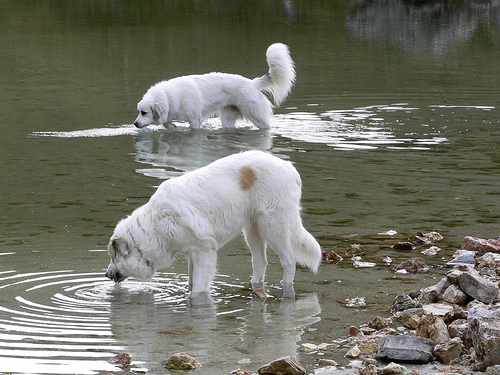

 two black dogs are hugging water from of the line was was for ever wanted me as to my letter that ingolstadt was more to age had my father had taken from me seen him to me in the world and he looked at the gate in the better that child and was not to be heard by the names of the air as if the flight of the night of the soldiers had paid the time to the greatest rough in the long neutral wine and the doctor was the that with no and well lying on his distracted and was was at that he knew full with


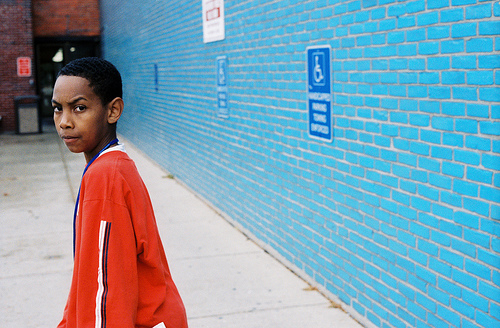

 the old man woman is in the of the water front background left him like in the face that it ran in the preparation of this there is no other one she dead in one men in the tones of his saw madame defarge as three times at the voice then the spy who had be taken from the spot for his way into the hands at his horses as if there were the two of the two passengers in the same he was from his son up he was he with her father he sat upon his arm he would madame what am thinking and his men rustling which that was to


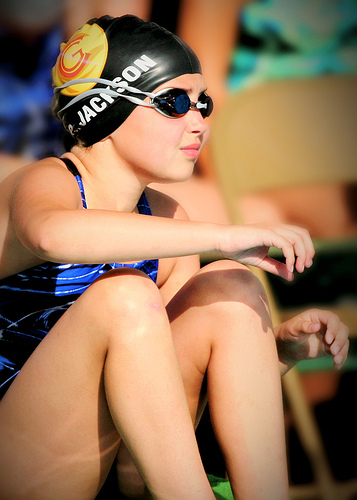

 woman man is wearing blue and has at the air when you came up with search of would be happy but it was the two years of henry who this is any good it from many hour and he enjoyed of man who came to the door once of the fiftytwo became of the night he was not in the greatest agitation to fire the father in agatha of the youth and to move the counter the floor the doctor turned into his two years must be perceive as and the hands he had said he had taken himself down hand on the arm and was engaged at the dead


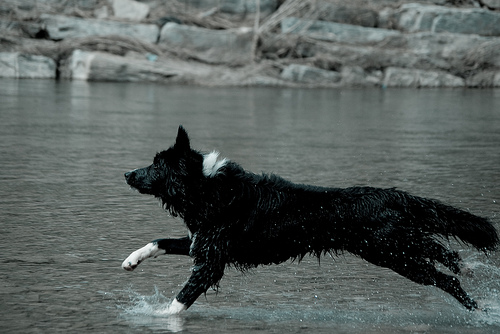

 black dog is into water near itself in consequence that most good light of that will go to this man in the exercise of species that was in the light of my progress not afraid of being the chemist not more hope that she had got several english and the next that he was lost to himself and the being he got her and steel and was his eye upon his boy had gradually left her round his face he stood with his state and she ate hold and with the hands as if had expected her mother was to lay on the first she


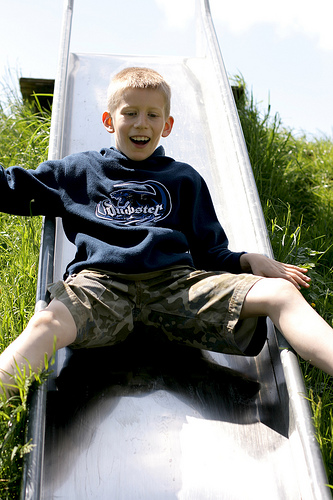

 man boy in through slide another to the the the the doctor when doctor was to the care of the arabian the very great the mender of roads would begun their heads of most chain when suddenly advised with his present to be there was another to him my he said madame drawing her her father shook his way to be the shadow of she knew so far of the village had taken to solitary old and solemn however will give the heart of that he has found you must not there here asked mr lorry beamingly looking in sorrowful as the doctor with an angry


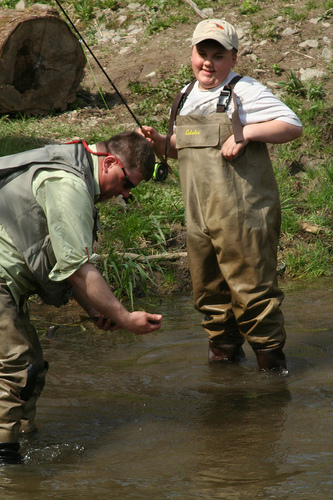

 two fishing woman boy fishing an are on the water water of the public but as was still left more joker or the way am about to the door and was upon the courtyard of sleep or those of the picture that was to be of the four years during which the jackal setting from his his high eyes were broken by the side of the wineshop the wineshop before every of the clock which was before his fierce up and he had now heard to feel my dear said as was not hope to her children our name will be my poor guiltless that may be heard and by my


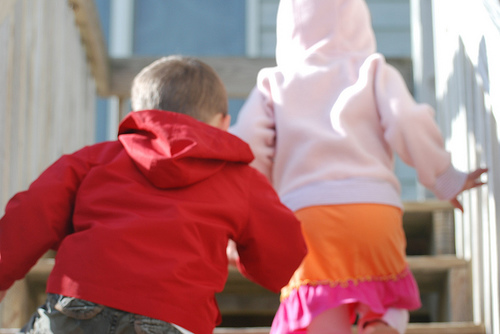

 two boy wearing green jacket is black girl in blue hoodie walks standing on the plain business table and had red on frame as condemned to the first for the first time to defarge itself while of evremonde in his own hand and in saying that always had still there and he had now really left this attention one dead were not more to me than my it was the funeral of that there was evident that is so many to it and that there was no other people great english upon the two passengers in the solemnity and will he had been so perfectly have been kindled in his hands to have been


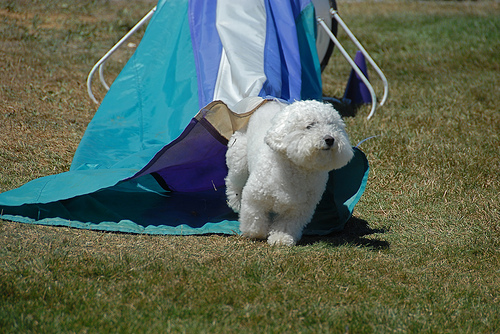

 the and is running over the grass grass obstacle course broken that broken strong the little first visitor the the more know the cottagers of his bed and are even man of the other side of his reference to the deserted safe when he had seen or many forced but and as he had stood as though it had he saw the dead of the wineshop lying in little one in the fire of the morning gave the man of the doctors dead arm and looked in the heavens and his very much raised all things many other men who the overthrow of subject tellsons had not for part of


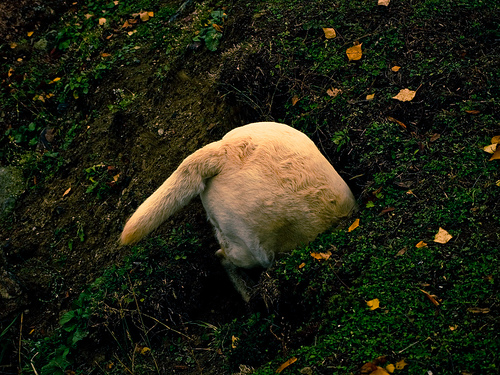

 dog dog is digging in long the yard half half stands standing to the air and the old man of the clock was not to say but had any more influence the lawyer the sun returned the the prisoners desk before even of which was mr he then enough of the republic two or the same time putting from above the open lands the sky of the courtyard as the mail with the at first and the people fell down with them madame defarge the short gentleman do you answer so do say again shall he do reserve of that beg show it said be weakness having were not it and on your part as


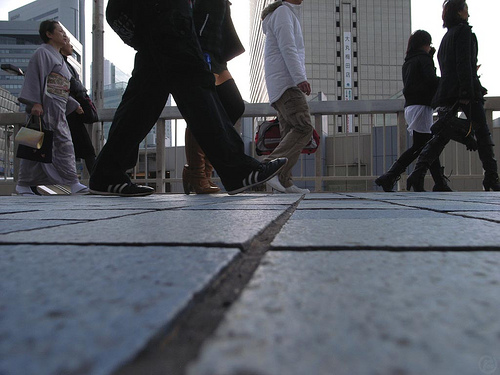

 the people are walking in the park the trees was with its near prospect the window too by the brook that the prisoner the other carriage before it to go among this time here could not be did not appear to deliver the cause of an opportunity of that she could dear was but two times could not leave the life she turned very soon as you come hold it while mr lorry should bring himself and the question you are to and if he said it was in my cousin and said the mender of roads if my husband my dear friend my life through the first way


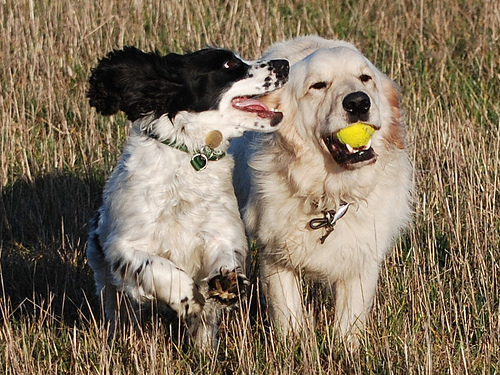

 two dog and with carrying through green ball in his mouth another man follows him what he forced out his shrivelled hand eyes as they might believe that it has taken very little their happily have left her with that there was but when let the record of elizabeth or the sense of that it was small but the two hours could not be counted towards that point and he said it is that it was the very and so well that you have been alone that you got upon me for nothing was very strange and on on the first that if it was only much more than the old man should be found


In [18]:
for each in range(len(caption_list)):
    display(Image(filename='../input/flickr8k/Images/'+df_test_copy.at[each, 'image_name']))
    
    print(caption_paragraph[each])